### Classify histopathology slides of Invasive Ductal Carcinoma (IDC) as either malignant or benign

##### Note: This is the initial version, accuracy obtained: 84.43%

### Breast Cancer Detection using Convolutional Neural Network (CNN)

#### Dataset Description

Dataset obtained from: http://www.andrewjanowczyk.com/use-case-6-invasive-ductal-carcinoma-idc-segmentation/
The original dataset consisted of 162 whole mount slide images of Breast Cancer (BCa) specimens scanned at 40x. From that, 277,524 patches of size 50  x 50 were extracted (198,738 IDC negative and 78,786 IDC positive).

Each patch’s file name is of the format:

u_xX_yY_classC.png   — > example 10253_idx5_x1351_y1101_class0.png

Where u is the patient ID (10253_idx5), X is the x-coordinate of where this patch was cropped from, Y is the y-coordinate of where this patch was cropped from, and C indicates the class where 0 is non-IDC and 1 is IDC.

### Tags: Image Classification, Breast Cancer Detection, CNN, Loading Data, Normalization, Data Augmentation, Random Undersampling, Train-test Split, Model Training, Model Evaluation, Prediction, ROC Curve, Precision, Recall, Accuracy 

### Tools: OpenCV, Python, Fnmatch, Glob, NumPy, Matplotlib, Keras, Scikit-Learn, Imblearn, Jupyter Notebook

### Import Dependencies

In [1]:
#! pip install opencv-python

In [4]:
from glob import glob #Finds all the pathnames matching a specified pattern
import fnmatch #Test whether the filename string matches the pattern string
import cv2 #Reading images

import numpy as np #Math

import matplotlib.pyplot as plt
%matplotlib inline

import keras
from keras.utils import to_categorical

#Train-test split
from sklearn.model_selection import train_test_split

#Resampling data
from imblearn.under_sampling import RandomUnderSampler

#Building the CNN model
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten
from keras.layers import Conv2D, MaxPooling2D
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras.models import load_model

#Evaluation metrics
from sklearn import metrics
from sklearn.metrics import classification_report, accuracy_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.metrics import precision_recall_curve 
from sklearn.metrics import average_precision_score

### Extract zip file

In [3]:
#Importing required modules 
from zipfile import ZipFile 
  
#Specifying the zip file name 
file_name = "IDC_regular_ps50_idx5.zip" #This file is in the current working directory
  
#Opening the zip file in READ mode 
with ZipFile(file_name, 'r') as zip: 
    #Printing all the contents of the zip file 
    zip.printdir() 
  
    #Extracting all the files 
    print('Extracting all the files now...') 
    zip.extractall() 
    print('Done!') 

File Name                                             Modified             Size
10253/                                         2014-03-13 18:16:16            0
10253/0/                                       2014-03-13 18:16:16            0
10253/0/10253_idx5_x1001_y1001_class0.png      2014-03-13 18:15:34         5936
10253/0/10253_idx5_x1001_y1051_class0.png      2014-03-13 18:15:34         5998
10253/0/10253_idx5_x1001_y1101_class0.png      2014-03-13 18:15:34         5480
10253/0/10253_idx5_x1001_y1151_class0.png      2014-03-13 18:15:34         5431
10253/0/10253_idx5_x1001_y1201_class0.png      2014-03-13 18:15:36         4176
10253/0/10253_idx5_x1001_y1251_class0.png      2014-03-13 18:15:36         6293
10253/0/10253_idx5_x1001_y1301_class0.png      2014-03-13 18:15:36         6514
10253/0/10253_idx5_x1001_y1351_class0.png      2014-03-13 18:15:36         6126
10253/0/10253_idx5_x1001_y1501_class0.png      2014-03-13 18:15:36         3498
10253/0/10253_idx5_x1001_y1551_class0.pn

10257/0/10257_idx5_x2201_y201_class0.png       2014-03-13 18:33:14         5891
10257/0/10257_idx5_x2201_y2151_class0.png      2014-03-13 18:33:16         5811
10257/0/10257_idx5_x2201_y251_class0.png       2014-03-13 18:33:14         6408
10257/0/10257_idx5_x2201_y301_class0.png       2014-03-13 18:33:14         6281
10257/0/10257_idx5_x2201_y351_class0.png       2014-03-13 18:33:14         6329
10257/0/10257_idx5_x2201_y401_class0.png       2014-03-13 18:33:14         5801
10257/0/10257_idx5_x2201_y601_class0.png       2014-03-13 18:33:14         6313
10257/0/10257_idx5_x2201_y651_class0.png       2014-03-13 18:33:14         6461
10257/0/10257_idx5_x2201_y701_class0.png       2014-03-13 18:33:14         6394
10257/0/10257_idx5_x2201_y751_class0.png       2014-03-13 18:33:16         6458
10257/0/10257_idx5_x2201_y801_class0.png       2014-03-13 18:33:16         6620
10257/0/10257_idx5_x2201_y851_class0.png       2014-03-13 18:33:16         5966
10257/0/10257_idx5_x2251_y151_class0.png

10259/0/10259_idx5_x301_y601_class0.png        2014-03-13 18:43:16         5648
10259/0/10259_idx5_x301_y651_class0.png        2014-03-13 18:43:16         5539
10259/0/10259_idx5_x301_y701_class0.png        2014-03-13 18:43:16         5885
10259/0/10259_idx5_x301_y751_class0.png        2014-03-13 18:43:16         5969
10259/0/10259_idx5_x301_y801_class0.png        2014-03-13 18:43:16         5595
10259/0/10259_idx5_x301_y851_class0.png        2014-03-13 18:43:16         5689
10259/0/10259_idx5_x301_y901_class0.png        2014-03-13 18:43:16         5337
10259/0/10259_idx5_x301_y951_class0.png        2014-03-13 18:43:16         5323
10259/0/10259_idx5_x351_y1001_class0.png       2014-03-13 18:43:18         5510
10259/0/10259_idx5_x351_y1051_class0.png       2014-03-13 18:43:20         5746
10259/0/10259_idx5_x351_y1101_class0.png       2014-03-13 18:43:20         5697
10259/0/10259_idx5_x351_y1151_class0.png       2014-03-13 18:43:20         5546
10259/0/10259_idx5_x351_y1201_class0.png

10261/0/10261_idx5_x851_y1301_class0.png       2014-03-13 18:55:30         6140
10261/0/10261_idx5_x851_y1351_class0.png       2014-03-13 18:55:30         5631
10261/0/10261_idx5_x851_y1701_class0.png       2014-03-13 18:55:30         5736
10261/0/10261_idx5_x851_y1751_class0.png       2014-03-13 18:55:30         5940
10261/0/10261_idx5_x851_y201_class0.png        2014-03-13 18:55:30         4362
10261/0/10261_idx5_x851_y301_class0.png        2014-03-13 18:55:30         6123
10261/0/10261_idx5_x851_y351_class0.png        2014-03-13 18:55:30         6461
10261/0/10261_idx5_x851_y401_class0.png        2014-03-13 18:55:30         6470
10261/0/10261_idx5_x851_y451_class0.png        2014-03-13 18:55:30         6032
10261/0/10261_idx5_x851_y501_class0.png        2014-03-13 18:55:30         6166
10261/0/10261_idx5_x851_y551_class0.png        2014-03-13 18:55:30         6179
10261/0/10261_idx5_x851_y601_class0.png        2014-03-13 18:55:30         6169
10261/0/10261_idx5_x851_y651_class0.png 

10264/0/10264_idx5_x251_y1951_class0.png       2014-03-13 19:07:46         5722
10264/0/10264_idx5_x251_y2001_class0.png       2014-03-13 19:07:46         5727
10264/0/10264_idx5_x251_y2051_class0.png       2014-03-13 19:07:46         4539
10264/0/10264_idx5_x2551_y1001_class0.png      2014-03-13 19:08:46         6644
10264/0/10264_idx5_x2551_y1051_class0.png      2014-03-13 19:08:46         5966
10264/0/10264_idx5_x2551_y301_class0.png       2014-03-13 19:08:44         4849
10264/0/10264_idx5_x2551_y351_class0.png       2014-03-13 19:08:44         6466
10264/0/10264_idx5_x2551_y401_class0.png       2014-03-13 19:08:44         6326
10264/0/10264_idx5_x2551_y451_class0.png       2014-03-13 19:08:44         3831
10264/0/10264_idx5_x2551_y501_class0.png       2014-03-13 19:08:44         4390
10264/0/10264_idx5_x2551_y551_class0.png       2014-03-13 19:08:44         5100
10264/0/10264_idx5_x2551_y601_class0.png       2014-03-13 19:08:44         5865
10264/0/10264_idx5_x2551_y651_class0.png

10268/0/10268_idx5_x501_y1801_class0.png       2014-03-13 19:16:04         6026
10268/0/10268_idx5_x501_y1851_class0.png       2014-03-13 19:16:04         6093
10268/0/10268_idx5_x501_y1901_class0.png       2014-03-13 19:16:04         6459
10268/0/10268_idx5_x501_y1951_class0.png       2014-03-13 19:16:04         6546
10268/0/10268_idx5_x501_y2001_class0.png       2014-03-13 19:16:04         6414
10268/0/10268_idx5_x501_y2051_class0.png       2014-03-13 19:16:04         2299
10268/0/10268_idx5_x501_y351_class0.png        2014-03-13 19:15:58         4506
10268/0/10268_idx5_x501_y401_class0.png        2014-03-13 19:15:58         5878
10268/0/10268_idx5_x501_y451_class0.png        2014-03-13 19:16:00         5977
10268/0/10268_idx5_x501_y501_class0.png        2014-03-13 19:16:00         5980
10268/0/10268_idx5_x501_y551_class0.png        2014-03-13 19:16:00         6077
10268/0/10268_idx5_x501_y601_class0.png        2014-03-13 19:16:00         6102
10268/0/10268_idx5_x501_y651_class0.png 

10272/0/10272_idx5_x2601_y401_class0.png       2014-03-13 19:34:00         4732
10272/0/10272_idx5_x2601_y451_class0.png       2014-03-13 19:34:00         5480
10272/0/10272_idx5_x2601_y501_class0.png       2014-03-13 19:34:00         5371
10272/0/10272_idx5_x2601_y551_class0.png       2014-03-13 19:34:00         5379
10272/0/10272_idx5_x2601_y601_class0.png       2014-03-13 19:34:00         5142
10272/0/10272_idx5_x2601_y651_class0.png       2014-03-13 19:34:00         5337
10272/0/10272_idx5_x2601_y701_class0.png       2014-03-13 19:34:02         5373
10272/0/10272_idx5_x2601_y751_class0.png       2014-03-13 19:34:02         5228
10272/0/10272_idx5_x2601_y801_class0.png       2014-03-13 19:34:02         5373
10272/0/10272_idx5_x2601_y851_class0.png       2014-03-13 19:34:02         5423
10272/0/10272_idx5_x2601_y901_class0.png       2014-03-13 19:34:02         5311
10272/0/10272_idx5_x2601_y951_class0.png       2014-03-13 19:34:02         5470
10272/0/10272_idx5_x2651_y1001_class0.pn

10273/1/10273_idx5_x1651_y1351_class1.png      2014-03-13 19:43:30         6371
10273/1/10273_idx5_x1651_y1401_class1.png      2014-03-13 19:43:30         6415
10273/1/10273_idx5_x1651_y1451_class1.png      2014-03-13 19:43:30         6498
10273/1/10273_idx5_x1651_y1501_class1.png      2014-03-13 19:43:32         6718
10273/1/10273_idx5_x1651_y1551_class1.png      2014-03-13 19:43:32         6569
10273/1/10273_idx5_x1651_y1601_class1.png      2014-03-13 19:43:32         6613
10273/1/10273_idx5_x1651_y1651_class1.png      2014-03-13 19:43:32         6393
10273/1/10273_idx5_x1651_y1701_class1.png      2014-03-13 19:43:32         6226
10273/1/10273_idx5_x1651_y1751_class1.png      2014-03-13 19:43:32         6200
10273/1/10273_idx5_x1651_y1801_class1.png      2014-03-13 19:43:32         6322
10273/1/10273_idx5_x1651_y1851_class1.png      2014-03-13 19:43:32         6280
10273/1/10273_idx5_x1651_y1901_class1.png      2014-03-13 19:43:32         6318
10273/1/10273_idx5_x1651_y1951_class1.pn

10275/1/10275_idx5_x2201_y1251_class1.png      2014-03-13 19:58:04         6234
10275/1/10275_idx5_x2201_y1301_class1.png      2014-03-13 19:58:04         6114
10275/1/10275_idx5_x2201_y1351_class1.png      2014-03-13 19:58:04         6097
10275/1/10275_idx5_x2201_y1401_class1.png      2014-03-13 19:58:04         6379
10275/1/10275_idx5_x2201_y1451_class1.png      2014-03-13 19:58:04         6002
10275/1/10275_idx5_x2201_y651_class1.png       2014-03-13 19:58:02         6506
10275/1/10275_idx5_x2201_y701_class1.png       2014-03-13 19:58:02         6331
10275/1/10275_idx5_x2201_y751_class1.png       2014-03-13 19:58:02         6284
10275/1/10275_idx5_x2201_y801_class1.png       2014-03-13 19:58:02         6359
10275/1/10275_idx5_x2201_y851_class1.png       2014-03-13 19:58:02         6564
10275/1/10275_idx5_x2201_y901_class1.png       2014-03-13 19:58:02         6373
10275/1/10275_idx5_x2201_y951_class1.png       2014-03-13 19:58:02         6263
10275/1/10275_idx5_x2251_y1001_class1.pn

10277/0/10277_idx5_x601_y1101_class0.png       2014-03-13 20:08:02         6303
10277/0/10277_idx5_x601_y1151_class0.png       2014-03-13 20:08:02         6281
10277/0/10277_idx5_x601_y1201_class0.png       2014-03-13 20:08:02         6377
10277/0/10277_idx5_x601_y1251_class0.png       2014-03-13 20:08:02         6033
10277/0/10277_idx5_x601_y1301_class0.png       2014-03-13 20:08:02         6576
10277/0/10277_idx5_x601_y1351_class0.png       2014-03-13 20:08:02         6523
10277/0/10277_idx5_x601_y1401_class0.png       2014-03-13 20:08:02         6465
10277/0/10277_idx5_x601_y1451_class0.png       2014-03-13 20:08:02         6239
10277/0/10277_idx5_x601_y1501_class0.png       2014-03-13 20:08:02         6094
10277/0/10277_idx5_x601_y1551_class0.png       2014-03-13 20:08:02         6113
10277/0/10277_idx5_x601_y1601_class0.png       2014-03-13 20:08:02         6830
10277/0/10277_idx5_x601_y1651_class0.png       2014-03-13 20:08:02         6103
10277/0/10277_idx5_x601_y1701_class0.png

10279/0/10279_idx5_x901_y851_class0.png        2014-03-13 20:37:44         2755
10279/0/10279_idx5_x951_y1001_class0.png       2014-03-13 20:37:48         6080
10279/0/10279_idx5_x951_y1051_class0.png       2014-03-13 20:37:48         6206
10279/0/10279_idx5_x951_y1101_class0.png       2014-03-13 20:37:48         6415
10279/0/10279_idx5_x951_y1151_class0.png       2014-03-13 20:37:48         6152
10279/0/10279_idx5_x951_y1201_class0.png       2014-03-13 20:37:48         6211
10279/0/10279_idx5_x951_y1251_class0.png       2014-03-13 20:37:50         6438
10279/0/10279_idx5_x951_y1301_class0.png       2014-03-13 20:37:50         6206
10279/0/10279_idx5_x951_y1351_class0.png       2014-03-13 20:37:50         5746
10279/0/10279_idx5_x951_y1451_class0.png       2014-03-13 20:37:50         5968
10279/0/10279_idx5_x951_y1501_class0.png       2014-03-13 20:37:50         6377
10279/0/10279_idx5_x951_y1551_class0.png       2014-03-13 20:37:50         6224
10279/0/10279_idx5_x951_y1601_class0.png

10285/0/10285_idx5_x2051_y601_class0.png       2014-03-13 21:01:30         5669
10285/0/10285_idx5_x2051_y651_class0.png       2014-03-13 21:01:30         5835
10285/0/10285_idx5_x2051_y701_class0.png       2014-03-13 21:01:32         5482
10285/0/10285_idx5_x2051_y751_class0.png       2014-03-13 21:01:32         6109
10285/0/10285_idx5_x2051_y801_class0.png       2014-03-13 21:01:32         6206
10285/0/10285_idx5_x2051_y851_class0.png       2014-03-13 21:01:32         6639
10285/0/10285_idx5_x2051_y901_class0.png       2014-03-13 21:01:32         5649
10285/0/10285_idx5_x2101_y1001_class0.png      2014-03-13 21:01:32         5304
10285/0/10285_idx5_x2101_y1051_class0.png      2014-03-13 21:01:32         5550
10285/0/10285_idx5_x2101_y2301_class0.png      2014-03-13 21:01:32         5292
10285/0/10285_idx5_x2101_y251_class0.png       2014-03-13 21:01:32         6079
10285/0/10285_idx5_x2101_y401_class0.png       2014-03-13 21:01:32         5846
10285/0/10285_idx5_x2101_y551_class0.png

10288/0/10288_idx5_x2301_y1551_class0.png      2014-03-13 21:07:16         5922
10288/0/10288_idx5_x2301_y1601_class0.png      2014-03-13 21:07:16         5980
10288/0/10288_idx5_x2301_y1651_class0.png      2014-03-13 21:07:16         5858
10288/0/10288_idx5_x2301_y1701_class0.png      2014-03-13 21:07:16         5806
10288/0/10288_idx5_x2301_y1751_class0.png      2014-03-13 21:07:16         5642
10288/0/10288_idx5_x2301_y1801_class0.png      2014-03-13 21:07:16         5908
10288/0/10288_idx5_x2301_y1851_class0.png      2014-03-13 21:07:16         5826
10288/0/10288_idx5_x2301_y1901_class0.png      2014-03-13 21:07:16         5929
10288/0/10288_idx5_x2301_y1951_class0.png      2014-03-13 21:07:16         5937
10288/0/10288_idx5_x2301_y2001_class0.png      2014-03-13 21:07:16         5945
10288/0/10288_idx5_x2301_y201_class0.png       2014-03-13 21:07:14         6233
10288/0/10288_idx5_x2301_y2051_class0.png      2014-03-13 21:07:16         5574
10288/0/10288_idx5_x2301_y2101_class0.pn

10290/0/10290_idx5_x3251_y951_class0.png       2014-03-13 21:11:20         6749
10290/0/10290_idx5_x3301_y1001_class0.png      2014-03-13 21:11:22         6602
10290/0/10290_idx5_x3301_y1051_class0.png      2014-03-13 21:11:22         6216
10290/0/10290_idx5_x3301_y1101_class0.png      2014-03-13 21:11:22         6235
10290/0/10290_idx5_x3301_y1151_class0.png      2014-03-13 21:11:22         3895
10290/0/10290_idx5_x3301_y1201_class0.png      2014-03-13 21:11:22         2688
10290/0/10290_idx5_x3301_y1251_class0.png      2014-03-13 21:11:22         3271
10290/0/10290_idx5_x3301_y1301_class0.png      2014-03-13 21:11:22         3563
10290/0/10290_idx5_x3301_y1351_class0.png      2014-03-13 21:11:22         2124
10290/0/10290_idx5_x3301_y701_class0.png       2014-03-13 21:11:22         4814
10290/0/10290_idx5_x3301_y751_class0.png       2014-03-13 21:11:22         6225
10290/0/10290_idx5_x3301_y801_class0.png       2014-03-13 21:11:22         6714
10290/0/10290_idx5_x3301_y851_class0.png

10292/0/10292_idx5_x2551_y201_class0.png       2014-03-13 21:17:16         5411
10292/0/10292_idx5_x2551_y251_class0.png       2014-03-13 21:17:16         3065
10292/0/10292_idx5_x2551_y301_class0.png       2014-03-13 21:17:16         5196
10292/0/10292_idx5_x2551_y351_class0.png       2014-03-13 21:17:16         6180
10292/0/10292_idx5_x2551_y401_class0.png       2014-03-13 21:17:16         5567
10292/0/10292_idx5_x2551_y501_class0.png       2014-03-13 21:17:16         5838
10292/0/10292_idx5_x2551_y551_class0.png       2014-03-13 21:17:18         5595
10292/0/10292_idx5_x2551_y601_class0.png       2014-03-13 21:17:18         5861
10292/0/10292_idx5_x2551_y651_class0.png       2014-03-13 21:17:18         5943
10292/0/10292_idx5_x2551_y701_class0.png       2014-03-13 21:17:18         5944
10292/0/10292_idx5_x2551_y751_class0.png       2014-03-13 21:17:18         6057
10292/0/10292_idx5_x2551_y801_class0.png       2014-03-13 21:17:18         5620
10292/0/10292_idx5_x2551_y851_class0.png

10295/0/10295_idx5_x1001_y1301_class0.png      2014-03-13 21:21:20         5593
10295/0/10295_idx5_x1001_y1351_class0.png      2014-03-13 21:21:20         5420
10295/0/10295_idx5_x1001_y1401_class0.png      2014-03-13 21:21:20         6104
10295/0/10295_idx5_x1001_y1451_class0.png      2014-03-13 21:21:22         5766
10295/0/10295_idx5_x1001_y1501_class0.png      2014-03-13 21:21:22         5806
10295/0/10295_idx5_x1001_y1551_class0.png      2014-03-13 21:21:22         5604
10295/0/10295_idx5_x1001_y1601_class0.png      2014-03-13 21:21:22         5429
10295/0/10295_idx5_x1001_y1651_class0.png      2014-03-13 21:21:22         5780
10295/0/10295_idx5_x1001_y1701_class0.png      2014-03-13 21:21:22         5948
10295/0/10295_idx5_x1001_y1751_class0.png      2014-03-13 21:21:22         6140
10295/0/10295_idx5_x1001_y1801_class0.png      2014-03-13 21:21:22         6330
10295/0/10295_idx5_x1001_y1851_class0.png      2014-03-13 21:21:22         6315
10295/0/10295_idx5_x1001_y1901_class0.pn

10299/1/10299_idx5_x1701_y701_class1.png       2014-03-13 21:24:48         6784
10299/1/10299_idx5_x1701_y751_class1.png       2014-03-13 21:24:48         6894
10299/1/10299_idx5_x1701_y801_class1.png       2014-03-13 21:24:48         6869
10299/1/10299_idx5_x1701_y851_class1.png       2014-03-13 21:24:48         6653
10299/1/10299_idx5_x1701_y901_class1.png       2014-03-13 21:24:48         6649
10299/1/10299_idx5_x1701_y951_class1.png       2014-03-13 21:24:48         6858
10299/1/10299_idx5_x1751_y1001_class1.png      2014-03-13 21:24:50         6858
10299/1/10299_idx5_x1751_y1051_class1.png      2014-03-13 21:24:50         6852
10299/1/10299_idx5_x1751_y1101_class1.png      2014-03-13 21:24:50         6716
10299/1/10299_idx5_x1751_y1151_class1.png      2014-03-13 21:24:50         6945
10299/1/10299_idx5_x1751_y1201_class1.png      2014-03-13 21:24:50         6834
10299/1/10299_idx5_x1751_y1251_class1.png      2014-03-13 21:24:50         6788
10299/1/10299_idx5_x1751_y1301_class1.pn

10301/0/10301_idx5_x1701_y1951_class0.png      2014-03-13 21:30:30         5364
10301/0/10301_idx5_x1701_y2001_class0.png      2014-03-13 21:30:30         5912
10301/0/10301_idx5_x1701_y201_class0.png       2014-03-13 21:30:30         5742
10301/0/10301_idx5_x1701_y2051_class0.png      2014-03-13 21:30:30         5919
10301/0/10301_idx5_x1701_y2101_class0.png      2014-03-13 21:30:30         6126
10301/0/10301_idx5_x1701_y2151_class0.png      2014-03-13 21:30:30         6021
10301/0/10301_idx5_x1701_y251_class0.png       2014-03-13 21:30:30         5962
10301/0/10301_idx5_x1701_y301_class0.png       2014-03-13 21:30:30         6052
10301/0/10301_idx5_x1701_y351_class0.png       2014-03-13 21:30:30         5545
10301/0/10301_idx5_x1701_y651_class0.png       2014-03-13 21:30:30         5805
10301/0/10301_idx5_x1701_y701_class0.png       2014-03-13 21:30:30         6085
10301/0/10301_idx5_x1751_y1151_class0.png      2014-03-13 21:30:32         5895
10301/0/10301_idx5_x1751_y1201_class0.pn

10302/1/10302_idx5_x2051_y301_class1.png       2014-03-13 21:34:08         6952
10302/1/10302_idx5_x2051_y351_class1.png       2014-03-13 21:34:08         6826
10302/1/10302_idx5_x2051_y401_class1.png       2014-03-13 21:34:08         6795
10302/1/10302_idx5_x2051_y451_class1.png       2014-03-13 21:34:08         7020
10302/1/10302_idx5_x2051_y501_class1.png       2014-03-13 21:34:08         7059
10302/1/10302_idx5_x2051_y551_class1.png       2014-03-13 21:34:08         6947
10302/1/10302_idx5_x2051_y601_class1.png       2014-03-13 21:34:08         6994
10302/1/10302_idx5_x2051_y651_class1.png       2014-03-13 21:34:08         7077
10302/1/10302_idx5_x2051_y701_class1.png       2014-03-13 21:34:08         7029
10302/1/10302_idx5_x2051_y751_class1.png       2014-03-13 21:34:08         6918
10302/1/10302_idx5_x2051_y801_class1.png       2014-03-13 21:34:08         6884
10302/1/10302_idx5_x2051_y851_class1.png       2014-03-13 21:34:08         6982
10302/1/10302_idx5_x2051_y901_class1.png

10304/0/10304_idx5_x351_y351_class0.png        2014-03-13 21:38:24         6038
10304/0/10304_idx5_x351_y401_class0.png        2014-03-13 21:38:24         5795
10304/0/10304_idx5_x351_y501_class0.png        2014-03-13 21:38:24         5776
10304/0/10304_idx5_x351_y751_class0.png        2014-03-13 21:38:24         6127
10304/0/10304_idx5_x351_y801_class0.png        2014-03-13 21:38:24         6349
10304/0/10304_idx5_x351_y851_class0.png        2014-03-13 21:38:24         6452
10304/0/10304_idx5_x351_y901_class0.png        2014-03-13 21:38:24         6495
10304/0/10304_idx5_x351_y951_class0.png        2014-03-13 21:38:24         6197
10304/0/10304_idx5_x401_y1051_class0.png       2014-03-13 21:38:26         6239
10304/0/10304_idx5_x401_y1101_class0.png       2014-03-13 21:38:26         6482
10304/0/10304_idx5_x401_y1151_class0.png       2014-03-13 21:38:26         6157
10304/0/10304_idx5_x401_y1201_class0.png       2014-03-13 21:38:26         6025
10304/0/10304_idx5_x401_y1251_class0.png

10306/0/10306_idx5_x1001_y1401_class0.png      2014-03-13 21:44:12         6060
10306/0/10306_idx5_x1001_y1451_class0.png      2014-03-13 21:44:12         6026
10306/0/10306_idx5_x1001_y1501_class0.png      2014-03-13 21:44:12         6571
10306/0/10306_idx5_x1001_y1551_class0.png      2014-03-13 21:44:12         6728
10306/0/10306_idx5_x1001_y1601_class0.png      2014-03-13 21:44:12         6363
10306/0/10306_idx5_x1001_y1651_class0.png      2014-03-13 21:44:12         6090
10306/0/10306_idx5_x1001_y1701_class0.png      2014-03-13 21:44:12         6362
10306/0/10306_idx5_x1001_y1751_class0.png      2014-03-13 21:44:12         5898
10306/0/10306_idx5_x1001_y301_class0.png       2014-03-13 21:44:12         5489
10306/0/10306_idx5_x1001_y451_class0.png       2014-03-13 21:44:12         4736
10306/0/10306_idx5_x1001_y751_class0.png       2014-03-13 21:44:12         6274
10306/0/10306_idx5_x1001_y801_class0.png       2014-03-13 21:44:12         5981
10306/0/10306_idx5_x1001_y851_class0.png

10308/0/10308_idx5_x1601_y301_class0.png       2014-03-13 21:49:54         5379
10308/0/10308_idx5_x1601_y351_class0.png       2014-03-13 21:49:54         5753
10308/0/10308_idx5_x1601_y401_class0.png       2014-03-13 21:49:54         5847
10308/0/10308_idx5_x1601_y451_class0.png       2014-03-13 21:49:54         6426
10308/0/10308_idx5_x1601_y501_class0.png       2014-03-13 21:49:54         6199
10308/0/10308_idx5_x1601_y51_class0.png        2014-03-13 21:49:54         6313
10308/0/10308_idx5_x1651_y101_class0.png       2014-03-13 21:49:56         6163
10308/0/10308_idx5_x1651_y151_class0.png       2014-03-13 21:49:56         5921
10308/0/10308_idx5_x1651_y1_class0.png         2014-03-13 21:49:56         4064
10308/0/10308_idx5_x1651_y201_class0.png       2014-03-13 21:49:56         6277
10308/0/10308_idx5_x1651_y2401_class0.png      2014-03-13 21:49:56         5784
10308/0/10308_idx5_x1651_y251_class0.png       2014-03-13 21:49:56         6018
10308/0/10308_idx5_x1651_y2551_class0.pn

12242/0/12242_idx5_x1901_y1451_class0.png      2014-03-13 21:54:28         5963
12242/0/12242_idx5_x1901_y1501_class0.png      2014-03-13 21:54:28         5836
12242/0/12242_idx5_x1901_y1551_class0.png      2014-03-13 21:54:28         6035
12242/0/12242_idx5_x1901_y1651_class0.png      2014-03-13 21:54:28         6540
12242/0/12242_idx5_x1901_y2051_class0.png      2014-03-13 21:54:28         3624
12242/0/12242_idx5_x1951_y1351_class0.png      2014-03-13 21:54:28         5953
12242/0/12242_idx5_x1951_y1401_class0.png      2014-03-13 21:54:28         6019
12242/0/12242_idx5_x1951_y1451_class0.png      2014-03-13 21:54:28         5986
12242/0/12242_idx5_x1951_y1551_class0.png      2014-03-13 21:54:28         6043
12242/0/12242_idx5_x1951_y1601_class0.png      2014-03-13 21:54:28         5318
12242/0/12242_idx5_x1951_y1651_class0.png      2014-03-13 21:54:28         6025
12242/0/12242_idx5_x1951_y2051_class0.png      2014-03-13 21:54:28         4724
12242/0/12242_idx5_x1951_y251_class0.png

12626/1/12626_idx5_x651_y2151_class1.png       2014-03-13 21:58:10         5716
12626/1/12626_idx5_x651_y2201_class1.png       2014-03-13 21:58:10         6056
12626/1/12626_idx5_x651_y2251_class1.png       2014-03-13 21:58:10         6051
12626/1/12626_idx5_x651_y2301_class1.png       2014-03-13 21:58:10         6111
12626/1/12626_idx5_x651_y2351_class1.png       2014-03-13 21:58:10         5955
12626/1/12626_idx5_x651_y951_class1.png        2014-03-13 21:58:08         6206
12626/1/12626_idx5_x701_y1001_class1.png       2014-03-13 21:58:10         6117
12626/1/12626_idx5_x701_y1051_class1.png       2014-03-13 21:58:10         6383
12626/1/12626_idx5_x701_y1101_class1.png       2014-03-13 21:58:10         6616
12626/1/12626_idx5_x701_y1151_class1.png       2014-03-13 21:58:10         6125
12626/1/12626_idx5_x701_y1751_class1.png       2014-03-13 21:58:10         5056
12626/1/12626_idx5_x701_y1801_class1.png       2014-03-13 21:58:10         6309
12626/1/12626_idx5_x701_y1851_class1.png

12750/0/12750_idx5_x1651_y651_class0.png       2014-03-13 22:05:32         6059
12750/0/12750_idx5_x1651_y701_class0.png       2014-03-13 22:05:32         5977
12750/0/12750_idx5_x1651_y751_class0.png       2014-03-13 22:05:32         5873
12750/0/12750_idx5_x1651_y801_class0.png       2014-03-13 22:05:32         5703
12750/0/12750_idx5_x1701_y1001_class0.png      2014-03-13 22:05:34         5826
12750/0/12750_idx5_x1701_y1051_class0.png      2014-03-13 22:05:34         6107
12750/0/12750_idx5_x1701_y1101_class0.png      2014-03-13 22:05:34         5954
12750/0/12750_idx5_x1701_y1151_class0.png      2014-03-13 22:05:34         5979
12750/0/12750_idx5_x1701_y1201_class0.png      2014-03-13 22:05:34         6116
12750/0/12750_idx5_x1701_y1251_class0.png      2014-03-13 22:05:34         5777
12750/0/12750_idx5_x1701_y1501_class0.png      2014-03-13 22:05:34         6066
12750/0/12750_idx5_x1701_y151_class0.png       2014-03-13 22:05:32         6591
12750/0/12750_idx5_x1701_y1551_class0.pn

12751/1/12751_idx5_x2051_y2351_class1.png      2014-03-13 22:08:44         6327
12751/1/12751_idx5_x2051_y2401_class1.png      2014-03-13 22:08:44         5708
12751/1/12751_idx5_x2051_y2451_class1.png      2014-03-13 22:08:44         5917
12751/1/12751_idx5_x2051_y2501_class1.png      2014-03-13 22:08:44         5837
12751/1/12751_idx5_x2051_y2551_class1.png      2014-03-13 22:08:44         5150
12751/1/12751_idx5_x2101_y1151_class1.png      2014-03-13 22:08:44         5940
12751/1/12751_idx5_x2101_y1201_class1.png      2014-03-13 22:08:44         5973
12751/1/12751_idx5_x2101_y1251_class1.png      2014-03-13 22:08:44         6203
12751/1/12751_idx5_x2101_y1301_class1.png      2014-03-13 22:08:44         6184
12751/1/12751_idx5_x2101_y1351_class1.png      2014-03-13 22:08:44         6188
12751/1/12751_idx5_x2101_y1401_class1.png      2014-03-13 22:08:44         6010
12751/1/12751_idx5_x2101_y1451_class1.png      2014-03-13 22:08:44         6153
12751/1/12751_idx5_x2101_y1501_class1.pn

12810/1/12810_idx5_x1401_y901_class1.png       2014-03-13 22:15:14         6332
12810/1/12810_idx5_x1401_y951_class1.png       2014-03-13 22:15:14         5907
12810/1/12810_idx5_x1451_y1201_class1.png      2014-03-13 22:15:14         6257
12810/1/12810_idx5_x1451_y1251_class1.png      2014-03-13 22:15:14         6375
12810/1/12810_idx5_x1451_y1301_class1.png      2014-03-13 22:15:14         6258
12810/1/12810_idx5_x1451_y1351_class1.png      2014-03-13 22:15:14         5554
12810/1/12810_idx5_x1451_y801_class1.png       2014-03-13 22:15:14         6356
12810/1/12810_idx5_x1451_y851_class1.png       2014-03-13 22:15:14         6881
12810/1/12810_idx5_x1451_y901_class1.png       2014-03-13 22:15:14         6143
12810/1/12810_idx5_x1451_y951_class1.png       2014-03-13 22:15:14         5884
12810/1/12810_idx5_x1501_y1101_class1.png      2014-03-13 22:15:14         6418
12810/1/12810_idx5_x1501_y1151_class1.png      2014-03-13 22:15:14         6416
12810/1/12810_idx5_x1501_y1201_class1.pn

12818/1/12818_idx5_x2251_y1451_class1.png      2014-03-13 22:22:34         6310
12818/1/12818_idx5_x2251_y1501_class1.png      2014-03-13 22:22:34         6399
12818/1/12818_idx5_x2251_y151_class1.png       2014-03-13 22:22:32         6000
12818/1/12818_idx5_x2251_y1551_class1.png      2014-03-13 22:22:34         5640
12818/1/12818_idx5_x2251_y1601_class1.png      2014-03-13 22:22:34         6338
12818/1/12818_idx5_x2251_y1651_class1.png      2014-03-13 22:22:34         6520
12818/1/12818_idx5_x2251_y1701_class1.png      2014-03-13 22:22:34         6257
12818/1/12818_idx5_x2251_y1751_class1.png      2014-03-13 22:22:34         6297
12818/1/12818_idx5_x2251_y1801_class1.png      2014-03-13 22:22:34         6355
12818/1/12818_idx5_x2251_y1851_class1.png      2014-03-13 22:22:36         6480
12818/1/12818_idx5_x2251_y1901_class1.png      2014-03-13 22:22:36         6369
12818/1/12818_idx5_x2251_y1951_class1.png      2014-03-13 22:22:36         6242
12818/1/12818_idx5_x2251_y2001_class1.pn

12820/0/12820_idx5_x2601_y1701_class0.png      2014-03-13 22:34:52         4114
12820/0/12820_idx5_x2601_y201_class0.png       2014-03-13 22:34:50         5896
12820/0/12820_idx5_x2601_y801_class0.png       2014-03-13 22:34:50         5711
12820/0/12820_idx5_x2601_y901_class0.png       2014-03-13 22:34:50         5623
12820/0/12820_idx5_x2651_y101_class0.png       2014-03-13 22:34:52         4006
12820/0/12820_idx5_x2651_y1101_class0.png      2014-03-13 22:34:52         4553
12820/0/12820_idx5_x2651_y1151_class0.png      2014-03-13 22:34:52         5173
12820/0/12820_idx5_x2651_y1201_class0.png      2014-03-13 22:34:52         4701
12820/0/12820_idx5_x2651_y1251_class0.png      2014-03-13 22:34:52         5483
12820/0/12820_idx5_x2651_y1301_class0.png      2014-03-13 22:34:52         4859
12820/0/12820_idx5_x2651_y1351_class0.png      2014-03-13 22:34:52         4893
12820/0/12820_idx5_x2651_y1401_class0.png      2014-03-13 22:34:52         5101
12820/0/12820_idx5_x2651_y1451_class0.pn

12821/1/12821_idx5_x1701_y1551_class1.png      2014-03-13 22:41:20         6310
12821/1/12821_idx5_x1701_y1601_class1.png      2014-03-13 22:41:20         6249
12821/1/12821_idx5_x1701_y1651_class1.png      2014-03-13 22:41:20         6311
12821/1/12821_idx5_x1701_y1701_class1.png      2014-03-13 22:41:20         6208
12821/1/12821_idx5_x1701_y1751_class1.png      2014-03-13 22:41:20         6104
12821/1/12821_idx5_x1701_y851_class1.png       2014-03-13 22:41:20         5450
12821/1/12821_idx5_x1701_y901_class1.png       2014-03-13 22:41:20         5953
12821/1/12821_idx5_x1701_y951_class1.png       2014-03-13 22:41:20         6372
12821/1/12821_idx5_x1751_y1001_class1.png      2014-03-13 22:41:22         6200
12821/1/12821_idx5_x1751_y1051_class1.png      2014-03-13 22:41:22         6292
12821/1/12821_idx5_x1751_y1101_class1.png      2014-03-13 22:41:22         6138
12821/1/12821_idx5_x1751_y1151_class1.png      2014-03-13 22:41:22         6214
12821/1/12821_idx5_x1751_y1201_class1.pn

12824/0/12824_idx5_x2601_y701_class0.png       2014-03-13 22:56:42         3929
12824/0/12824_idx5_x2601_y751_class0.png       2014-03-13 22:56:42         5803
12824/0/12824_idx5_x2601_y801_class0.png       2014-03-13 22:56:42         5915
12824/0/12824_idx5_x2601_y851_class0.png       2014-03-13 22:56:42         4824
12824/0/12824_idx5_x2601_y901_class0.png       2014-03-13 22:56:42         5611
12824/0/12824_idx5_x2601_y951_class0.png       2014-03-13 22:56:42         5860
12824/0/12824_idx5_x2651_y1001_class0.png      2014-03-13 22:56:44         6061
12824/0/12824_idx5_x2651_y1051_class0.png      2014-03-13 22:56:44         6112
12824/0/12824_idx5_x2651_y1101_class0.png      2014-03-13 22:56:44         5748
12824/0/12824_idx5_x2651_y1151_class0.png      2014-03-13 22:56:44         5882
12824/0/12824_idx5_x2651_y1201_class0.png      2014-03-13 22:56:44         6154
12824/0/12824_idx5_x2651_y1251_class0.png      2014-03-13 22:56:44         6119
12824/0/12824_idx5_x2651_y1301_class0.pn

12867/0/12867_idx5_x651_y1751_class0.png       2014-03-13 23:08:30         5310
12867/0/12867_idx5_x651_y1801_class0.png       2014-03-13 23:08:30         5364
12867/0/12867_idx5_x651_y1851_class0.png       2014-03-13 23:08:30         5466
12867/0/12867_idx5_x651_y1901_class0.png       2014-03-13 23:08:30         4920
12867/0/12867_idx5_x651_y1951_class0.png       2014-03-13 23:08:30         4930
12867/0/12867_idx5_x651_y2001_class0.png       2014-03-13 23:08:30         5081
12867/0/12867_idx5_x651_y2051_class0.png       2014-03-13 23:08:30         4968
12867/0/12867_idx5_x651_y2101_class0.png       2014-03-13 23:08:30         5448
12867/0/12867_idx5_x651_y801_class0.png        2014-03-13 23:08:30         4776
12867/0/12867_idx5_x651_y851_class0.png        2014-03-13 23:08:30         5212
12867/0/12867_idx5_x651_y901_class0.png        2014-03-13 23:08:30         5271
12867/0/12867_idx5_x651_y951_class0.png        2014-03-13 23:08:30         5796
12867/0/12867_idx5_x701_y1001_class0.png

12868/1/12868_idx5_x1401_y2151_class1.png      2014-03-13 23:15:38         5705
12868/1/12868_idx5_x1401_y2201_class1.png      2014-03-13 23:15:38         5256
12868/1/12868_idx5_x1451_y1101_class1.png      2014-03-13 23:15:38         6169
12868/1/12868_idx5_x1451_y1151_class1.png      2014-03-13 23:15:40         5975
12868/1/12868_idx5_x1451_y1201_class1.png      2014-03-13 23:15:40         5910
12868/1/12868_idx5_x1451_y1251_class1.png      2014-03-13 23:15:40         6226
12868/1/12868_idx5_x1451_y1301_class1.png      2014-03-13 23:15:40         6238
12868/1/12868_idx5_x1451_y1351_class1.png      2014-03-13 23:15:40         6108
12868/1/12868_idx5_x1451_y1401_class1.png      2014-03-13 23:15:40         6297
12868/1/12868_idx5_x1451_y1451_class1.png      2014-03-13 23:15:40         6209
12868/1/12868_idx5_x1451_y1501_class1.png      2014-03-13 23:15:40         6276
12868/1/12868_idx5_x1451_y1551_class1.png      2014-03-13 23:15:40         6263
12868/1/12868_idx5_x1451_y1601_class1.pn

12872/0/12872_idx5_x551_y1151_class0.png       2014-03-13 23:30:50         5670
12872/0/12872_idx5_x551_y1451_class0.png       2014-03-13 23:30:50         5044
12872/0/12872_idx5_x551_y501_class0.png        2014-03-13 23:30:50         4603
12872/0/12872_idx5_x551_y551_class0.png        2014-03-13 23:30:50         6262
12872/0/12872_idx5_x551_y601_class0.png        2014-03-13 23:30:50         6034
12872/0/12872_idx5_x551_y651_class0.png        2014-03-13 23:30:50         5973
12872/0/12872_idx5_x551_y701_class0.png        2014-03-13 23:30:50         5240
12872/0/12872_idx5_x551_y751_class0.png        2014-03-13 23:30:50         5564
12872/0/12872_idx5_x551_y801_class0.png        2014-03-13 23:30:50         5611
12872/0/12872_idx5_x551_y851_class0.png        2014-03-13 23:30:50         5513
12872/0/12872_idx5_x551_y901_class0.png        2014-03-13 23:30:50         5125
12872/0/12872_idx5_x551_y951_class0.png        2014-03-13 23:30:50         5261
12872/0/12872_idx5_x601_y1001_class0.png

12878/0/12878_idx5_x751_y1101_class0.png       2014-03-13 23:45:02         5805
12878/0/12878_idx5_x751_y1151_class0.png       2014-03-13 23:45:02         5632
12878/0/12878_idx5_x751_y1251_class0.png       2014-03-13 23:45:02         4861
12878/0/12878_idx5_x751_y1301_class0.png       2014-03-13 23:45:02         5129
12878/0/12878_idx5_x751_y1351_class0.png       2014-03-13 23:45:02         6077
12878/0/12878_idx5_x751_y1401_class0.png       2014-03-13 23:45:02         5637
12878/0/12878_idx5_x751_y1501_class0.png       2014-03-13 23:45:02         5846
12878/0/12878_idx5_x751_y151_class0.png        2014-03-13 23:45:02         5665
12878/0/12878_idx5_x751_y1551_class0.png       2014-03-13 23:45:02         5671
12878/0/12878_idx5_x751_y1601_class0.png       2014-03-13 23:45:02         6084
12878/0/12878_idx5_x751_y1651_class0.png       2014-03-13 23:45:02         6181
12878/0/12878_idx5_x751_y1701_class0.png       2014-03-13 23:45:02         6036
12878/0/12878_idx5_x751_y1751_class0.png

12880/1/12880_idx5_x201_y1351_class1.png       2014-03-13 23:53:56         6512
12880/1/12880_idx5_x201_y1401_class1.png       2014-03-13 23:53:56         6345
12880/1/12880_idx5_x201_y1451_class1.png       2014-03-13 23:53:56         6085
12880/1/12880_idx5_x201_y1501_class1.png       2014-03-13 23:53:56         6299
12880/1/12880_idx5_x201_y1551_class1.png       2014-03-13 23:53:56         5876
12880/1/12880_idx5_x2051_y1001_class1.png      2014-03-13 23:55:28         5980
12880/1/12880_idx5_x2051_y1051_class1.png      2014-03-13 23:55:28         6083
12880/1/12880_idx5_x2051_y1101_class1.png      2014-03-13 23:55:28         6349
12880/1/12880_idx5_x2051_y1151_class1.png      2014-03-13 23:55:28         6053
12880/1/12880_idx5_x2051_y1201_class1.png      2014-03-13 23:55:28         6107
12880/1/12880_idx5_x2051_y1251_class1.png      2014-03-13 23:55:28         6213
12880/1/12880_idx5_x2051_y1301_class1.png      2014-03-13 23:55:28         6053
12880/1/12880_idx5_x2051_y1351_class1.pn

12886/0/12886_idx5_x1451_y301_class0.png       2014-03-14 00:09:40         5047
12886/0/12886_idx5_x1451_y351_class0.png       2014-03-14 00:09:40         5470
12886/0/12886_idx5_x1451_y401_class0.png       2014-03-14 00:09:40         5887
12886/0/12886_idx5_x1451_y451_class0.png       2014-03-14 00:09:40         5879
12886/0/12886_idx5_x1451_y501_class0.png       2014-03-14 00:09:40         5825
12886/0/12886_idx5_x1451_y551_class0.png       2014-03-14 00:09:40         5669
12886/0/12886_idx5_x1451_y601_class0.png       2014-03-14 00:09:40         5618
12886/0/12886_idx5_x1451_y651_class0.png       2014-03-14 00:09:40         5512
12886/0/12886_idx5_x1451_y701_class0.png       2014-03-14 00:09:40         5617
12886/0/12886_idx5_x1451_y751_class0.png       2014-03-14 00:09:40         5554
12886/0/12886_idx5_x1451_y801_class0.png       2014-03-14 00:09:40         5437
12886/0/12886_idx5_x1451_y851_class0.png       2014-03-14 00:09:40         5773
12886/0/12886_idx5_x1451_y901_class0.png

12891/1/12891_idx5_x2001_y1301_class1.png      2014-03-14 00:20:32         6186
12891/1/12891_idx5_x2001_y1351_class1.png      2014-03-14 00:20:32         5735
12891/1/12891_idx5_x2001_y951_class1.png       2014-03-14 00:20:32         5982
12891/1/12891_idx5_x2051_y1001_class1.png      2014-03-14 00:20:32         5926
12891/1/12891_idx5_x2051_y1051_class1.png      2014-03-14 00:20:32         6090
12891/1/12891_idx5_x2051_y1151_class1.png      2014-03-14 00:20:34         6001
12891/1/12891_idx5_x2051_y1201_class1.png      2014-03-14 00:20:34         5988
12891/1/12891_idx5_x2051_y1251_class1.png      2014-03-14 00:20:34         5165
12891/1/12891_idx5_x2051_y1301_class1.png      2014-03-14 00:20:34         2777
12891/1/12891_idx5_x2051_y951_class1.png       2014-03-14 00:20:32         5271
12891/1/12891_idx5_x501_y701_class1.png        2014-03-14 00:20:18         6042
12891/1/12891_idx5_x501_y751_class1.png        2014-03-14 00:20:18         6237
12891/1/12891_idx5_x501_y801_class1.png 

12894/1/12894_idx5_x1751_y1951_class1.png      2014-03-14 00:32:24         6326
12894/1/12894_idx5_x1751_y2001_class1.png      2014-03-14 00:32:26         6374
12894/1/12894_idx5_x1751_y201_class1.png       2014-03-14 00:32:22         5688
12894/1/12894_idx5_x1751_y251_class1.png       2014-03-14 00:32:22         5668
12894/1/12894_idx5_x1751_y301_class1.png       2014-03-14 00:32:22         5832
12894/1/12894_idx5_x1751_y351_class1.png       2014-03-14 00:32:22         5973
12894/1/12894_idx5_x1751_y401_class1.png       2014-03-14 00:32:22         6028
12894/1/12894_idx5_x1751_y451_class1.png       2014-03-14 00:32:22         6094
12894/1/12894_idx5_x1751_y501_class1.png       2014-03-14 00:32:22         6090
12894/1/12894_idx5_x1751_y551_class1.png       2014-03-14 00:32:22         6024
12894/1/12894_idx5_x1751_y601_class1.png       2014-03-14 00:32:22         6082
12894/1/12894_idx5_x1751_y651_class1.png       2014-03-14 00:32:22         6183
12894/1/12894_idx5_x1751_y701_class1.png

12896/0/12896_idx5_x1501_y651_class0.png       2014-03-14 00:44:38         4684
12896/0/12896_idx5_x1501_y701_class0.png       2014-03-14 00:44:38         6272
12896/0/12896_idx5_x1501_y751_class0.png       2014-03-14 00:44:38         6422
12896/0/12896_idx5_x1501_y801_class0.png       2014-03-14 00:44:38         6012
12896/0/12896_idx5_x1501_y901_class0.png       2014-03-14 00:44:38         5865
12896/0/12896_idx5_x1551_y1001_class0.png      2014-03-14 00:44:40         6178
12896/0/12896_idx5_x1551_y1051_class0.png      2014-03-14 00:44:40         6101
12896/0/12896_idx5_x1551_y1101_class0.png      2014-03-14 00:44:40         6190
12896/0/12896_idx5_x1551_y1151_class0.png      2014-03-14 00:44:40         5901
12896/0/12896_idx5_x1551_y1351_class0.png      2014-03-14 00:44:40         5195
12896/0/12896_idx5_x1551_y1401_class0.png      2014-03-14 00:44:40         5912
12896/0/12896_idx5_x1551_y1451_class0.png      2014-03-14 00:44:40         5697
12896/0/12896_idx5_x1551_y1551_class0.pn

12900/1/12900_idx5_x1951_y1801_class1.png      2014-03-14 00:58:04         6285
12900/1/12900_idx5_x1951_y1851_class1.png      2014-03-14 00:58:04         6372
12900/1/12900_idx5_x1951_y1901_class1.png      2014-03-14 00:58:04         6329
12900/1/12900_idx5_x1951_y1951_class1.png      2014-03-14 00:58:04         6285
12900/1/12900_idx5_x1951_y2001_class1.png      2014-03-14 00:58:04         6045
12900/1/12900_idx5_x1951_y2051_class1.png      2014-03-14 00:58:04         5905
12900/1/12900_idx5_x1951_y2101_class1.png      2014-03-14 00:58:04         5882
12900/1/12900_idx5_x1951_y2151_class1.png      2014-03-14 00:58:06         5710
12900/1/12900_idx5_x2001_y1001_class1.png      2014-03-14 00:58:06         5807
12900/1/12900_idx5_x2001_y1051_class1.png      2014-03-14 00:58:06         5928
12900/1/12900_idx5_x2001_y1101_class1.png      2014-03-14 00:58:06         5977
12900/1/12900_idx5_x2001_y1401_class1.png      2014-03-14 00:58:06         6559
12900/1/12900_idx5_x2001_y1451_class1.pn

12906/0/12906_idx5_x1151_y1951_class0.png      2014-03-14 01:16:26         5588
12906/0/12906_idx5_x1151_y2301_class0.png      2014-03-14 01:16:26         5532
12906/0/12906_idx5_x1151_y2351_class0.png      2014-03-14 01:16:26         5748
12906/0/12906_idx5_x1151_y2401_class0.png      2014-03-14 01:16:26         5873
12906/0/12906_idx5_x1151_y2451_class0.png      2014-03-14 01:16:26         6053
12906/0/12906_idx5_x1151_y401_class0.png       2014-03-14 01:16:24         4829
12906/0/12906_idx5_x1151_y451_class0.png       2014-03-14 01:16:24         5871
12906/0/12906_idx5_x1151_y501_class0.png       2014-03-14 01:16:24         5800
12906/0/12906_idx5_x1151_y551_class0.png       2014-03-14 01:16:24         5760
12906/0/12906_idx5_x1151_y651_class0.png       2014-03-14 01:16:24         5814
12906/0/12906_idx5_x1151_y751_class0.png       2014-03-14 01:16:24         5014
12906/0/12906_idx5_x1151_y801_class0.png       2014-03-14 01:16:24         5770
12906/0/12906_idx5_x1151_y851_class0.png

12907/1/12907_idx5_x2451_y1701_class1.png      2014-03-14 01:26:04         6358
12907/1/12907_idx5_x2451_y1751_class1.png      2014-03-14 01:26:04         6624
12907/1/12907_idx5_x2451_y1801_class1.png      2014-03-14 01:26:04         6846
12907/1/12907_idx5_x2451_y1851_class1.png      2014-03-14 01:26:04         6823
12907/1/12907_idx5_x2451_y1901_class1.png      2014-03-14 01:26:04         6665
12907/1/12907_idx5_x2451_y1951_class1.png      2014-03-14 01:26:04         6516
12907/1/12907_idx5_x2451_y2001_class1.png      2014-03-14 01:26:04         6670
12907/1/12907_idx5_x2451_y2051_class1.png      2014-03-14 01:26:04         6691
12907/1/12907_idx5_x2451_y2101_class1.png      2014-03-14 01:26:04         6603
12907/1/12907_idx5_x2451_y2151_class1.png      2014-03-14 01:26:04         6783
12907/1/12907_idx5_x2451_y2201_class1.png      2014-03-14 01:26:04         6769
12907/1/12907_idx5_x2451_y2251_class1.png      2014-03-14 01:26:04         6568
12907/1/12907_idx5_x2451_y2301_class1.pn

12910/0/12910_idx5_x2101_y1001_class0.png      2014-03-14 01:36:20         5031
12910/0/12910_idx5_x2101_y101_class0.png       2014-03-14 01:36:20         5637
12910/0/12910_idx5_x2101_y1051_class0.png      2014-03-14 01:36:20         5158
12910/0/12910_idx5_x2101_y1101_class0.png      2014-03-14 01:36:20         5053
12910/0/12910_idx5_x2101_y1151_class0.png      2014-03-14 01:36:20         4868
12910/0/12910_idx5_x2101_y1201_class0.png      2014-03-14 01:36:20         4762
12910/0/12910_idx5_x2101_y1251_class0.png      2014-03-14 01:36:20         4597
12910/0/12910_idx5_x2101_y1301_class0.png      2014-03-14 01:36:20         4842
12910/0/12910_idx5_x2101_y1351_class0.png      2014-03-14 01:36:20         4612
12910/0/12910_idx5_x2101_y1401_class0.png      2014-03-14 01:36:20         4896
12910/0/12910_idx5_x2101_y151_class0.png       2014-03-14 01:36:20         5398
12910/0/12910_idx5_x2101_y201_class0.png       2014-03-14 01:36:20         5421
12910/0/12910_idx5_x2101_y251_class0.png

12911/1/12911_idx5_x1601_y1401_class1.png      2014-03-14 01:41:16         5856
12911/1/12911_idx5_x1601_y1451_class1.png      2014-03-14 01:41:16         6123
12911/1/12911_idx5_x1601_y1501_class1.png      2014-03-14 01:41:16         6384
12911/1/12911_idx5_x1601_y1551_class1.png      2014-03-14 01:41:16         6369
12911/1/12911_idx5_x1651_y1101_class1.png      2014-03-14 01:41:16         6292
12911/1/12911_idx5_x1651_y1151_class1.png      2014-03-14 01:41:16         6257
12911/1/12911_idx5_x1651_y1201_class1.png      2014-03-14 01:41:16         6194
12911/1/12911_idx5_x1651_y1251_class1.png      2014-03-14 01:41:16         6423
12911/1/12911_idx5_x1651_y1451_class1.png      2014-03-14 01:41:16         6230
12911/1/12911_idx5_x1651_y1501_class1.png      2014-03-14 01:41:16         6230
12911/1/12911_idx5_x1651_y1551_class1.png      2014-03-14 01:41:16         6317
12911/1/12911_idx5_x1701_y1101_class1.png      2014-03-14 01:41:16         6458
12911/1/12911_idx5_x1701_y1151_class1.pn

12932/0/12932_idx5_x2701_y1801_class0.png      2014-03-14 01:49:26         5000
12932/0/12932_idx5_x2701_y1851_class0.png      2014-03-14 01:49:26         5465
12932/0/12932_idx5_x2701_y1901_class0.png      2014-03-14 01:49:26         5767
12932/0/12932_idx5_x2701_y1951_class0.png      2014-03-14 01:49:26         6023
12932/0/12932_idx5_x2701_y2001_class0.png      2014-03-14 01:49:26         2779
12932/0/12932_idx5_x2701_y2051_class0.png      2014-03-14 01:49:26         3984
12932/0/12932_idx5_x2701_y2101_class0.png      2014-03-14 01:49:26         4379
12932/0/12932_idx5_x2701_y2151_class0.png      2014-03-14 01:49:26         3076
12932/0/12932_idx5_x2701_y2201_class0.png      2014-03-14 01:49:26         4004
12932/0/12932_idx5_x2701_y2251_class0.png      2014-03-14 01:49:26         3834
12932/0/12932_idx5_x2701_y2551_class0.png      2014-03-14 01:49:26         4391
12932/0/12932_idx5_x2701_y2601_class0.png      2014-03-14 01:49:26          204
12932/0/12932_idx5_x2751_y1601_class0.pn

12934/1/12934_idx5_x2801_y1451_class1.png      2014-03-14 01:53:36         5821
12934/1/12934_idx5_x2801_y1501_class1.png      2014-03-14 01:53:36         6301
12934/1/12934_idx5_x2801_y1551_class1.png      2014-03-14 01:53:36         6269
12934/1/12934_idx5_x2801_y1601_class1.png      2014-03-14 01:53:36         6186
12934/1/12934_idx5_x2801_y1651_class1.png      2014-03-14 01:53:36         6229
12934/1/12934_idx5_x2801_y1701_class1.png      2014-03-14 01:53:36         6215
12934/1/12934_idx5_x2801_y1751_class1.png      2014-03-14 01:53:36         6224
12934/1/12934_idx5_x2801_y1801_class1.png      2014-03-14 01:53:36         6167
12934/1/12934_idx5_x2801_y1851_class1.png      2014-03-14 01:53:36         6096
12934/1/12934_idx5_x2801_y1901_class1.png      2014-03-14 01:53:36         6148
12934/1/12934_idx5_x2801_y1951_class1.png      2014-03-14 01:53:36         5997
12934/1/12934_idx5_x2801_y2001_class1.png      2014-03-14 01:53:36         5927
12934/1/12934_idx5_x2801_y2051_class1.pn

12949/0/12949_idx5_x1651_y1851_class0.png      2014-03-14 01:59:44         5118
12949/0/12949_idx5_x1651_y201_class0.png       2014-03-14 01:59:44         5367
12949/0/12949_idx5_x1651_y351_class0.png       2014-03-14 01:59:44         5441
12949/0/12949_idx5_x1651_y51_class0.png        2014-03-14 01:59:44         4746
12949/0/12949_idx5_x1701_y1801_class0.png      2014-03-14 01:59:44         5870
12949/0/12949_idx5_x1701_y1851_class0.png      2014-03-14 01:59:44         3351
12949/0/12949_idx5_x1701_y351_class0.png       2014-03-14 01:59:44         5432
12949/0/12949_idx5_x1701_y51_class0.png        2014-03-14 01:59:44         5168
12949/0/12949_idx5_x1751_y101_class0.png       2014-03-14 01:59:44         5854
12949/0/12949_idx5_x1751_y1751_class0.png      2014-03-14 01:59:44         5838
12949/0/12949_idx5_x1751_y1801_class0.png      2014-03-14 01:59:44         5982
12949/0/12949_idx5_x1751_y1851_class0.png      2014-03-14 01:59:44         3832
12949/0/12949_idx5_x1751_y51_class0.png 

12954/0/12954_idx5_x1401_y2801_class0.png      2014-03-14 02:04:26         5682
12954/0/12954_idx5_x1401_y2951_class0.png      2014-03-14 02:04:26         1764
12954/0/12954_idx5_x1401_y301_class0.png       2014-03-14 02:04:24         6021
12954/0/12954_idx5_x1401_y351_class0.png       2014-03-14 02:04:24         6210
12954/0/12954_idx5_x1401_y401_class0.png       2014-03-14 02:04:24         5931
12954/0/12954_idx5_x1401_y451_class0.png       2014-03-14 02:04:24         5781
12954/0/12954_idx5_x1401_y501_class0.png       2014-03-14 02:04:24         6159
12954/0/12954_idx5_x1401_y551_class0.png       2014-03-14 02:04:24         6072
12954/0/12954_idx5_x1401_y601_class0.png       2014-03-14 02:04:24         6034
12954/0/12954_idx5_x1401_y651_class0.png       2014-03-14 02:04:24         5982
12954/0/12954_idx5_x1401_y701_class0.png       2014-03-14 02:04:24         5890
12954/0/12954_idx5_x1401_y751_class0.png       2014-03-14 02:04:24         6362
12954/0/12954_idx5_x1401_y801_class0.png

12955/0/12955_idx5_x651_y801_class0.png        2014-03-14 02:06:38         5548
12955/0/12955_idx5_x651_y851_class0.png        2014-03-14 02:06:38         5433
12955/0/12955_idx5_x651_y901_class0.png        2014-03-14 02:06:38         5724
12955/0/12955_idx5_x651_y951_class0.png        2014-03-14 02:06:38         6072
12955/0/12955_idx5_x701_y1001_class0.png       2014-03-14 02:06:38         5546
12955/0/12955_idx5_x701_y1051_class0.png       2014-03-14 02:06:38         5536
12955/0/12955_idx5_x701_y1101_class0.png       2014-03-14 02:06:38         5851
12955/0/12955_idx5_x701_y1351_class0.png       2014-03-14 02:06:38         5444
12955/0/12955_idx5_x701_y1401_class0.png       2014-03-14 02:06:38         5299
12955/0/12955_idx5_x701_y1601_class0.png       2014-03-14 02:06:38         5738
12955/0/12955_idx5_x701_y1701_class0.png       2014-03-14 02:06:38         5717
12955/0/12955_idx5_x701_y1801_class0.png       2014-03-14 02:06:38         4675
12955/0/12955_idx5_x701_y1851_class0.png

13020/0/13020_idx5_x301_y1401_class0.png       2014-03-14 02:11:18         5679
13020/0/13020_idx5_x301_y1451_class0.png       2014-03-14 02:11:18         5721
13020/0/13020_idx5_x301_y1501_class0.png       2014-03-14 02:11:18         5765
13020/0/13020_idx5_x351_y1351_class0.png       2014-03-14 02:11:18         5517
13020/0/13020_idx5_x351_y1401_class0.png       2014-03-14 02:11:18         5369
13020/0/13020_idx5_x351_y1451_class0.png       2014-03-14 02:11:18         5527
13020/0/13020_idx5_x351_y1501_class0.png       2014-03-14 02:11:18         5609
13020/0/13020_idx5_x351_y1551_class0.png       2014-03-14 02:11:18         5696
13020/0/13020_idx5_x401_y1251_class0.png       2014-03-14 02:11:18         5863
13020/0/13020_idx5_x401_y1301_class0.png       2014-03-14 02:11:18         5672
13020/0/13020_idx5_x401_y1651_class0.png       2014-03-14 02:11:18         5406
13020/0/13020_idx5_x401_y2201_class0.png       2014-03-14 02:11:18         5648
13020/0/13020_idx5_x401_y901_class0.png 

13022/0/13022_idx5_x2401_y1201_class0.png      2014-03-14 02:15:10         5867
13022/0/13022_idx5_x2401_y1251_class0.png      2014-03-14 02:15:10         5636
13022/0/13022_idx5_x2401_y1301_class0.png      2014-03-14 02:15:10         5453
13022/0/13022_idx5_x2401_y1351_class0.png      2014-03-14 02:15:10         5291
13022/0/13022_idx5_x2401_y1401_class0.png      2014-03-14 02:15:10         5497
13022/0/13022_idx5_x2401_y1451_class0.png      2014-03-14 02:15:10         5655
13022/0/13022_idx5_x2401_y1501_class0.png      2014-03-14 02:15:10         6286
13022/0/13022_idx5_x2401_y201_class0.png       2014-03-14 02:15:10         5642
13022/0/13022_idx5_x2401_y2901_class0.png      2014-03-14 02:15:10         2500
13022/0/13022_idx5_x2401_y701_class0.png       2014-03-14 02:15:10         4539
13022/0/13022_idx5_x2401_y951_class0.png       2014-03-14 02:15:10         6227
13022/0/13022_idx5_x2451_y1001_class0.png      2014-03-14 02:15:12         5986
13022/0/13022_idx5_x2451_y1051_class0.pn

13025/0/13025_idx5_x2751_y1251_class0.png      2014-03-14 02:18:56         5479
13025/0/13025_idx5_x2751_y1701_class0.png      2014-03-14 02:18:58         5401
13025/0/13025_idx5_x2751_y1751_class0.png      2014-03-14 02:18:58         4703
13025/0/13025_idx5_x2801_y1701_class0.png      2014-03-14 02:18:58         5325
13025/0/13025_idx5_x2801_y601_class0.png       2014-03-14 02:18:58         5365
13025/0/13025_idx5_x2901_y1701_class0.png      2014-03-14 02:18:58         3878
13025/0/13025_idx5_x2951_y1151_class0.png      2014-03-14 02:18:58         5809
13025/0/13025_idx5_x2951_y1651_class0.png      2014-03-14 02:18:58         5365
13025/0/13025_idx5_x2951_y401_class0.png       2014-03-14 02:18:58         4977
13025/0/13025_idx5_x3001_y1201_class0.png      2014-03-14 02:18:58         5652
13025/0/13025_idx5_x3001_y1651_class0.png      2014-03-14 02:18:58         4222
13025/0/13025_idx5_x3001_y351_class0.png       2014-03-14 02:18:58         5354
13025/0/13025_idx5_x3001_y401_class0.png

13400/0/13400_idx5_x2451_y1651_class0.png      2014-03-14 02:21:26         5849
13400/0/13400_idx5_x2451_y1701_class0.png      2014-03-14 02:21:26         5972
13400/0/13400_idx5_x2451_y1751_class0.png      2014-03-14 02:21:26         5918
13400/0/13400_idx5_x2451_y1801_class0.png      2014-03-14 02:21:26         5732
13400/0/13400_idx5_x2451_y1851_class0.png      2014-03-14 02:21:26         5790
13400/0/13400_idx5_x2451_y1901_class0.png      2014-03-14 02:21:26         5611
13400/0/13400_idx5_x2451_y1951_class0.png      2014-03-14 02:21:26         5676
13400/0/13400_idx5_x2451_y2001_class0.png      2014-03-14 02:21:26         5688
13400/0/13400_idx5_x2451_y2051_class0.png      2014-03-14 02:21:26         5766
13400/0/13400_idx5_x2451_y2101_class0.png      2014-03-14 02:21:26         5753
13400/0/13400_idx5_x2451_y2151_class0.png      2014-03-14 02:21:26         5683
13400/0/13400_idx5_x2451_y2201_class0.png      2014-03-14 02:21:26         5578
13400/0/13400_idx5_x2451_y2251_class0.pn

13404/0/13404_idx5_x601_y2901_class0.png       2014-03-14 02:26:50         1910
13404/0/13404_idx5_x651_y1401_class0.png       2014-03-14 02:26:50         6088
13404/0/13404_idx5_x651_y1451_class0.png       2014-03-14 02:26:50         5680
13404/0/13404_idx5_x651_y1501_class0.png       2014-03-14 02:26:50         5413
13404/0/13404_idx5_x651_y1551_class0.png       2014-03-14 02:26:50         5367
13404/0/13404_idx5_x651_y2901_class0.png       2014-03-14 02:26:50         2134
13404/0/13404_idx5_x701_y1351_class0.png       2014-03-14 02:26:50         5906
13404/0/13404_idx5_x701_y1401_class0.png       2014-03-14 02:26:50         6087
13404/0/13404_idx5_x701_y1451_class0.png       2014-03-14 02:26:50         6016
13404/0/13404_idx5_x701_y1551_class0.png       2014-03-14 02:26:50         6081
13404/0/13404_idx5_x701_y1601_class0.png       2014-03-14 02:26:50         5483
13404/0/13404_idx5_x701_y2901_class0.png       2014-03-14 02:26:50         2016
13404/0/13404_idx5_x751_y1301_class0.png

13460/0/13460_idx5_x551_y2051_class0.png       2014-03-14 02:30:24         5831
13460/0/13460_idx5_x551_y2101_class0.png       2014-03-14 02:30:24         6186
13460/0/13460_idx5_x601_y1051_class0.png       2014-03-14 02:30:24         6726
13460/0/13460_idx5_x601_y1101_class0.png       2014-03-14 02:30:24         6171
13460/0/13460_idx5_x601_y1251_class0.png       2014-03-14 02:30:24         5690
13460/0/13460_idx5_x601_y1301_class0.png       2014-03-14 02:30:24         5799
13460/0/13460_idx5_x601_y1351_class0.png       2014-03-14 02:30:24         5748
13460/0/13460_idx5_x601_y1401_class0.png       2014-03-14 02:30:24         6163
13460/0/13460_idx5_x601_y1551_class0.png       2014-03-14 02:30:24         5791
13460/0/13460_idx5_x601_y1651_class0.png       2014-03-14 02:30:24         5757
13460/0/13460_idx5_x601_y1701_class0.png       2014-03-14 02:30:24         5676
13460/0/13460_idx5_x601_y1751_class0.png       2014-03-14 02:30:24         6113
13460/0/13460_idx5_x601_y1801_class0.png

13462/1/13462_idx5_x1751_y1701_class1.png      2014-03-14 02:34:54         6270
13462/1/13462_idx5_x1751_y1751_class1.png      2014-03-14 02:34:54         6187
13462/1/13462_idx5_x1751_y1801_class1.png      2014-03-14 02:34:54         5877
13462/1/13462_idx5_x1751_y1851_class1.png      2014-03-14 02:34:54         5724
13462/1/13462_idx5_x1751_y2051_class1.png      2014-03-14 02:34:54         5377
13462/1/13462_idx5_x1751_y2101_class1.png      2014-03-14 02:34:54         5379
13462/1/13462_idx5_x1801_y1351_class1.png      2014-03-14 02:34:54         4397
13462/1/13462_idx5_x1801_y1401_class1.png      2014-03-14 02:34:54         5318
13462/1/13462_idx5_x1801_y1451_class1.png      2014-03-14 02:34:54         4355
13462/1/13462_idx5_x1801_y1601_class1.png      2014-03-14 02:34:54         4500
13462/1/13462_idx5_x1801_y1651_class1.png      2014-03-14 02:34:54         5853
13462/1/13462_idx5_x1801_y1701_class1.png      2014-03-14 02:34:54         5871
13462/1/13462_idx5_x1801_y1751_class1.pn

13613/1/13613_idx5_x2251_y2301_class1.png      2014-03-14 02:42:52         5025
13613/1/13613_idx5_x2301_y1051_class1.png      2014-03-14 02:42:52         5802
13613/1/13613_idx5_x2301_y1101_class1.png      2014-03-14 02:42:52         6298
13613/1/13613_idx5_x2301_y1151_class1.png      2014-03-14 02:42:52         6368
13613/1/13613_idx5_x2301_y1201_class1.png      2014-03-14 02:42:52         6398
13613/1/13613_idx5_x2301_y1251_class1.png      2014-03-14 02:42:52         6334
13613/1/13613_idx5_x2301_y1301_class1.png      2014-03-14 02:42:52         6431
13613/1/13613_idx5_x2301_y1351_class1.png      2014-03-14 02:42:52         6426
13613/1/13613_idx5_x2301_y1401_class1.png      2014-03-14 02:42:52         6421
13613/1/13613_idx5_x2301_y1451_class1.png      2014-03-14 02:42:52         6181
13613/1/13613_idx5_x2301_y1501_class1.png      2014-03-14 02:42:52         6114
13613/1/13613_idx5_x2301_y1551_class1.png      2014-03-14 02:42:52         6290
13613/1/13613_idx5_x2301_y1601_class1.pn

13687/0/13687_idx5_x1751_y201_class0.png       2014-03-14 02:47:28         4843
13687/0/13687_idx5_x1801_y151_class0.png       2014-03-14 02:47:28         5082
13687/0/13687_idx5_x1801_y201_class0.png       2014-03-14 02:47:28         5406
13687/0/13687_idx5_x1851_y1251_class0.png      2014-03-14 02:47:28         5312
13687/0/13687_idx5_x1851_y201_class0.png       2014-03-14 02:47:28         5434
13687/0/13687_idx5_x1851_y251_class0.png       2014-03-14 02:47:28         4981
13687/0/13687_idx5_x1901_y1251_class0.png      2014-03-14 02:47:30         5271
13687/0/13687_idx5_x1901_y1301_class0.png      2014-03-14 02:47:30         6519
13687/0/13687_idx5_x1901_y201_class0.png       2014-03-14 02:47:28         5363
13687/0/13687_idx5_x1901_y251_class0.png       2014-03-14 02:47:30         5642
13687/0/13687_idx5_x1951_y1351_class0.png      2014-03-14 02:47:30         6630
13687/0/13687_idx5_x1951_y1401_class0.png      2014-03-14 02:47:30         5114
13687/0/13687_idx5_x1951_y201_class0.png

13691/0/13691_idx5_x3801_y251_class0.png       2014-03-14 02:51:54         2684
13691/0/13691_idx5_x3801_y301_class0.png       2014-03-14 02:51:54         4294
13691/0/13691_idx5_x3801_y351_class0.png       2014-03-14 02:51:54         5501
13691/0/13691_idx5_x3801_y401_class0.png       2014-03-14 02:51:54         4420
13691/0/13691_idx5_x3801_y451_class0.png       2014-03-14 02:51:54         2037
13691/0/13691_idx5_x3801_y501_class0.png       2014-03-14 02:51:54         2081
13691/0/13691_idx5_x3801_y551_class0.png       2014-03-14 02:51:54         2100
13691/0/13691_idx5_x3801_y601_class0.png       2014-03-14 02:51:54         2027
13691/0/13691_idx5_x3801_y651_class0.png       2014-03-14 02:51:54         2044
13691/0/13691_idx5_x3801_y951_class0.png       2014-03-14 02:51:54         2133
13691/0/13691_idx5_x3851_y1001_class0.png      2014-03-14 02:51:54         1993
13691/0/13691_idx5_x3851_y1_class0.png         2014-03-14 02:51:54         2366
13691/0/13691_idx5_x3851_y251_class0.png

13693/0/13693_idx5_x2251_y1551_class0.png      2014-03-14 02:56:58         5795
13693/0/13693_idx5_x2251_y1601_class0.png      2014-03-14 02:56:58         5999
13693/0/13693_idx5_x2251_y1651_class0.png      2014-03-14 02:56:58         5497
13693/0/13693_idx5_x2251_y1701_class0.png      2014-03-14 02:56:58         5771
13693/0/13693_idx5_x2251_y1751_class0.png      2014-03-14 02:56:58         5402
13693/0/13693_idx5_x2251_y1851_class0.png      2014-03-14 02:56:58         4049
13693/0/13693_idx5_x2251_y1901_class0.png      2014-03-14 02:56:58         5681
13693/0/13693_idx5_x2251_y1951_class0.png      2014-03-14 02:56:58         5556
13693/0/13693_idx5_x2251_y2001_class0.png      2014-03-14 02:56:58         6044
13693/0/13693_idx5_x2251_y2051_class0.png      2014-03-14 02:56:58         5903
13693/0/13693_idx5_x2251_y2101_class0.png      2014-03-14 02:56:58         5404
13693/0/13693_idx5_x2251_y2151_class0.png      2014-03-14 02:56:58         4894
13693/0/13693_idx5_x2251_y2201_class0.pn

13694/1/13694_idx5_x1951_y1951_class1.png      2014-03-14 02:59:16         6459
13694/1/13694_idx5_x1951_y2001_class1.png      2014-03-14 02:59:16         6345
13694/1/13694_idx5_x1951_y2051_class1.png      2014-03-14 02:59:16         6378
13694/1/13694_idx5_x1951_y2101_class1.png      2014-03-14 02:59:18         6514
13694/1/13694_idx5_x1951_y2151_class1.png      2014-03-14 02:59:18         6124
13694/1/13694_idx5_x1951_y2201_class1.png      2014-03-14 02:59:18         5999
13694/1/13694_idx5_x1951_y2251_class1.png      2014-03-14 02:59:18         5694
13694/1/13694_idx5_x1951_y2301_class1.png      2014-03-14 02:59:20         6097
13694/1/13694_idx5_x1951_y2351_class1.png      2014-03-14 02:59:20         6205
13694/1/13694_idx5_x1951_y2401_class1.png      2014-03-14 02:59:20         6079
13694/1/13694_idx5_x1951_y951_class1.png       2014-03-14 02:59:16         6136
13694/1/13694_idx5_x2001_y1151_class1.png      2014-03-14 02:59:20         5382
13694/1/13694_idx5_x2001_y1201_class1.pn

14079/0/14079_idx5_x351_y2051_class0.png       2014-03-14 03:03:32         4938
14079/0/14079_idx5_x351_y2101_class0.png       2014-03-14 03:03:32         5244
14079/0/14079_idx5_x401_y1001_class0.png       2014-03-14 03:03:32         5554
14079/0/14079_idx5_x401_y1051_class0.png       2014-03-14 03:03:32         5107
14079/0/14079_idx5_x401_y1951_class0.png       2014-03-14 03:03:32         5147
14079/0/14079_idx5_x401_y2001_class0.png       2014-03-14 03:03:32         5177
14079/0/14079_idx5_x401_y2501_class0.png       2014-03-14 03:03:32         5617
14079/0/14079_idx5_x451_y1001_class0.png       2014-03-14 03:03:32         5467
14079/0/14079_idx5_x451_y1901_class0.png       2014-03-14 03:03:32         5263
14079/0/14079_idx5_x451_y1951_class0.png       2014-03-14 03:03:32         5465
14079/0/14079_idx5_x501_y1851_class0.png       2014-03-14 03:03:32         5418
14079/0/14079_idx5_x501_y1901_class0.png       2014-03-14 03:03:32         5480
14079/0/14079_idx5_x551_y1801_class0.png

14154/0/14154_idx5_x3051_y1501_class0.png      2014-03-14 03:10:48         6277
14154/0/14154_idx5_x3051_y1551_class0.png      2014-03-14 03:10:48         6336
14154/0/14154_idx5_x3051_y1601_class0.png      2014-03-14 03:10:48         6193
14154/0/14154_idx5_x3051_y1651_class0.png      2014-03-14 03:10:48         6101
14154/0/14154_idx5_x3051_y1701_class0.png      2014-03-14 03:10:48         6022
14154/0/14154_idx5_x3051_y1751_class0.png      2014-03-14 03:10:48         6147
14154/0/14154_idx5_x3051_y1801_class0.png      2014-03-14 03:10:48         6386
14154/0/14154_idx5_x3051_y1851_class0.png      2014-03-14 03:10:48         6390
14154/0/14154_idx5_x3051_y1901_class0.png      2014-03-14 03:10:48         6237
14154/0/14154_idx5_x3051_y1951_class0.png      2014-03-14 03:10:48         6308
14154/0/14154_idx5_x3051_y2001_class0.png      2014-03-14 03:10:48         6343
14154/0/14154_idx5_x3051_y2051_class0.png      2014-03-14 03:10:48         5544
14154/0/14154_idx5_x3051_y651_class0.png

14155/1/14155_idx5_x1701_y1201_class1.png      2014-03-14 03:13:32         6551
14155/1/14155_idx5_x1701_y1251_class1.png      2014-03-14 03:13:32         6567
14155/1/14155_idx5_x1701_y1301_class1.png      2014-03-14 03:13:32         6514
14155/1/14155_idx5_x1701_y451_class1.png       2014-03-14 03:13:32         5574
14155/1/14155_idx5_x1701_y501_class1.png       2014-03-14 03:13:32         6345
14155/1/14155_idx5_x1701_y551_class1.png       2014-03-14 03:13:32         6167
14155/1/14155_idx5_x1701_y601_class1.png       2014-03-14 03:13:32         6407
14155/1/14155_idx5_x1701_y651_class1.png       2014-03-14 03:13:32         6322
14155/1/14155_idx5_x1701_y701_class1.png       2014-03-14 03:13:32         5666
14155/1/14155_idx5_x1701_y751_class1.png       2014-03-14 03:13:32         6085
14155/1/14155_idx5_x1701_y801_class1.png       2014-03-14 03:13:32         6505
14155/1/14155_idx5_x1701_y851_class1.png       2014-03-14 03:13:32         6108
14155/1/14155_idx5_x1701_y901_class1.png

14157/0/14157_idx5_x2901_y1401_class0.png      2014-03-14 03:18:40         6053
14157/0/14157_idx5_x2901_y1451_class0.png      2014-03-14 03:18:40         5837
14157/0/14157_idx5_x2901_y1501_class0.png      2014-03-14 03:18:40         5793
14157/0/14157_idx5_x2901_y1551_class0.png      2014-03-14 03:18:40         5869
14157/0/14157_idx5_x2901_y1601_class0.png      2014-03-14 03:18:40         5652
14157/0/14157_idx5_x2901_y1651_class0.png      2014-03-14 03:18:40         5818
14157/0/14157_idx5_x2901_y1701_class0.png      2014-03-14 03:18:40         5805
14157/0/14157_idx5_x2901_y1751_class0.png      2014-03-14 03:18:40         5736
14157/0/14157_idx5_x2901_y1801_class0.png      2014-03-14 03:18:40         5353
14157/0/14157_idx5_x2901_y1851_class0.png      2014-03-14 03:18:40         5694
14157/0/14157_idx5_x2901_y2401_class0.png      2014-03-14 03:18:40         2192
14157/0/14157_idx5_x2901_y2451_class0.png      2014-03-14 03:18:40          176
14157/0/14157_idx5_x2901_y351_class0.png

14189/0/14189_idx5_x501_y1651_class0.png       2014-03-14 03:21:58         5918
14189/0/14189_idx5_x501_y1851_class0.png       2014-03-14 03:21:58         5454
14189/0/14189_idx5_x501_y1901_class0.png       2014-03-14 03:21:58         5619
14189/0/14189_idx5_x501_y2001_class0.png       2014-03-14 03:21:58         4490
14189/0/14189_idx5_x501_y751_class0.png        2014-03-14 03:21:58         5805
14189/0/14189_idx5_x551_y1301_class0.png       2014-03-14 03:21:58         5894
14189/0/14189_idx5_x551_y1351_class0.png       2014-03-14 03:21:58         5757
14189/0/14189_idx5_x551_y1451_class0.png       2014-03-14 03:21:58         5969
14189/0/14189_idx5_x551_y1501_class0.png       2014-03-14 03:21:58         5980
14189/0/14189_idx5_x551_y1651_class0.png       2014-03-14 03:21:58         5759
14189/0/14189_idx5_x551_y1801_class0.png       2014-03-14 03:21:58         5612
14189/0/14189_idx5_x551_y1851_class0.png       2014-03-14 03:21:58         5917
14189/0/14189_idx5_x551_y1901_class0.png

14191/1/14191_idx5_x2001_y1501_class1.png      2014-03-14 03:26:12         6492
14191/1/14191_idx5_x2001_y1551_class1.png      2014-03-14 03:26:12         6478
14191/1/14191_idx5_x2001_y1601_class1.png      2014-03-14 03:26:12         6501
14191/1/14191_idx5_x2001_y1651_class1.png      2014-03-14 03:26:12         6431
14191/1/14191_idx5_x2001_y1701_class1.png      2014-03-14 03:26:12         6053
14191/1/14191_idx5_x2001_y1751_class1.png      2014-03-14 03:26:12         6418
14191/1/14191_idx5_x2001_y1801_class1.png      2014-03-14 03:26:12         6218
14191/1/14191_idx5_x2001_y1851_class1.png      2014-03-14 03:26:12         6388
14191/1/14191_idx5_x2001_y1901_class1.png      2014-03-14 03:26:12         6092
14191/1/14191_idx5_x2001_y1951_class1.png      2014-03-14 03:26:12         6267
14191/1/14191_idx5_x2001_y2001_class1.png      2014-03-14 03:26:12         6488
14191/1/14191_idx5_x2001_y2051_class1.png      2014-03-14 03:26:12         6613
14191/1/14191_idx5_x2001_y2101_class1.pn

14211/0/14211_idx5_x151_y351_class0.png        2014-03-14 03:32:16         5131
14211/0/14211_idx5_x151_y451_class0.png        2014-03-14 03:32:16         5428
14211/0/14211_idx5_x151_y501_class0.png        2014-03-14 03:32:16         5587
14211/0/14211_idx5_x151_y551_class0.png        2014-03-14 03:32:16         5748
14211/0/14211_idx5_x151_y601_class0.png        2014-03-14 03:32:16         5664
14211/0/14211_idx5_x151_y651_class0.png        2014-03-14 03:32:16         5424
14211/0/14211_idx5_x1551_y151_class0.png       2014-03-14 03:32:36         5154
14211/0/14211_idx5_x1551_y1651_class0.png      2014-03-14 03:32:36         6251
14211/0/14211_idx5_x1551_y1701_class0.png      2014-03-14 03:32:36         6330
14211/0/14211_idx5_x1551_y1751_class0.png      2014-03-14 03:32:36         6032
14211/0/14211_idx5_x1551_y1801_class0.png      2014-03-14 03:32:36         5670
14211/0/14211_idx5_x1551_y1951_class0.png      2014-03-14 03:32:36         5645
14211/0/14211_idx5_x1551_y2001_class0.pn

14213/1/14213_idx5_x1851_y1051_class1.png      2014-03-14 03:36:36         6305
14213/1/14213_idx5_x1851_y1101_class1.png      2014-03-14 03:36:36         6000
14213/1/14213_idx5_x1851_y1151_class1.png      2014-03-14 03:36:36         6097
14213/1/14213_idx5_x1851_y1201_class1.png      2014-03-14 03:36:36         6103
14213/1/14213_idx5_x1851_y1251_class1.png      2014-03-14 03:36:36         6094
14213/1/14213_idx5_x1851_y1301_class1.png      2014-03-14 03:36:36         6241
14213/1/14213_idx5_x1851_y1351_class1.png      2014-03-14 03:36:36         6478
14213/1/14213_idx5_x1851_y1401_class1.png      2014-03-14 03:36:36         6472
14213/1/14213_idx5_x1851_y1451_class1.png      2014-03-14 03:36:36         6405
14213/1/14213_idx5_x1851_y1501_class1.png      2014-03-14 03:36:36         6599
14213/1/14213_idx5_x1851_y1551_class1.png      2014-03-14 03:36:36         6368
14213/1/14213_idx5_x1851_y1601_class1.png      2014-03-14 03:36:36         6181
14213/1/14213_idx5_x1851_y601_class1.png

14306/0/14306_idx5_x1601_y1851_class0.png      2014-03-14 03:40:56         5424
14306/0/14306_idx5_x1601_y701_class0.png       2014-03-14 03:40:56         6050
14306/0/14306_idx5_x1601_y751_class0.png       2014-03-14 03:40:56         5684
14306/0/14306_idx5_x1601_y801_class0.png       2014-03-14 03:40:56         5587
14306/0/14306_idx5_x1601_y851_class0.png       2014-03-14 03:40:56         5771
14306/0/14306_idx5_x1601_y901_class0.png       2014-03-14 03:40:56         5662
14306/0/14306_idx5_x1601_y951_class0.png       2014-03-14 03:40:56         5370
14306/0/14306_idx5_x1651_y1051_class0.png      2014-03-14 03:40:56         5500
14306/0/14306_idx5_x1651_y1251_class0.png      2014-03-14 03:40:56         5822
14306/0/14306_idx5_x1651_y1351_class0.png      2014-03-14 03:40:56         6340
14306/0/14306_idx5_x1651_y1401_class0.png      2014-03-14 03:40:56         5544
14306/0/14306_idx5_x1651_y1601_class0.png      2014-03-14 03:40:56         6068
14306/0/14306_idx5_x1651_y1651_class0.pn

15472/0/15472_idx5_x2201_y1601_class0.png      2014-03-14 03:45:18         5615
15472/0/15472_idx5_x2201_y2151_class0.png      2014-03-14 03:45:18         3481
15472/0/15472_idx5_x2201_y2201_class0.png      2014-03-14 03:45:18         2584
15472/0/15472_idx5_x2201_y2251_class0.png      2014-03-14 03:45:18          530
15472/0/15472_idx5_x2201_y251_class0.png       2014-03-14 03:45:18         5262
15472/0/15472_idx5_x2201_y301_class0.png       2014-03-14 03:45:18         5386
15472/0/15472_idx5_x2201_y451_class0.png       2014-03-14 03:45:18         6169
15472/0/15472_idx5_x2201_y501_class0.png       2014-03-14 03:45:18         6018
15472/0/15472_idx5_x2201_y551_class0.png       2014-03-14 03:45:18         5964
15472/0/15472_idx5_x2201_y601_class0.png       2014-03-14 03:45:18         5855
15472/0/15472_idx5_x2201_y651_class0.png       2014-03-14 03:45:18         5644
15472/0/15472_idx5_x2201_y701_class0.png       2014-03-14 03:45:18         6228
15472/0/15472_idx5_x2201_y751_class0.png

15473/1/15473_idx5_x2151_y1851_class1.png      2014-03-14 03:48:02         6437
15473/1/15473_idx5_x2151_y1901_class1.png      2014-03-14 03:48:02         6322
15473/1/15473_idx5_x2151_y1951_class1.png      2014-03-14 03:48:02         6577
15473/1/15473_idx5_x2151_y2001_class1.png      2014-03-14 03:48:02         6661
15473/1/15473_idx5_x2151_y2051_class1.png      2014-03-14 03:48:02         6774
15473/1/15473_idx5_x2151_y801_class1.png       2014-03-14 03:48:00         6600
15473/1/15473_idx5_x2151_y851_class1.png       2014-03-14 03:48:00         6649
15473/1/15473_idx5_x2151_y901_class1.png       2014-03-14 03:48:00         6723
15473/1/15473_idx5_x2151_y951_class1.png       2014-03-14 03:48:00         6763
15473/1/15473_idx5_x2201_y1001_class1.png      2014-03-14 03:48:02         6895
15473/1/15473_idx5_x2201_y1051_class1.png      2014-03-14 03:48:02         6781
15473/1/15473_idx5_x2201_y1101_class1.png      2014-03-14 03:48:02         6710
15473/1/15473_idx5_x2201_y1151_class1.pn

15514/0/15514_idx5_x3101_y301_class0.png       2014-03-14 03:53:28         3078
15514/0/15514_idx5_x3101_y351_class0.png       2014-03-14 03:53:28         5574
15514/0/15514_idx5_x3101_y401_class0.png       2014-03-14 03:53:28         5470
15514/0/15514_idx5_x3101_y451_class0.png       2014-03-14 03:53:28         5911
15514/0/15514_idx5_x3101_y601_class0.png       2014-03-14 03:53:28         4093
15514/0/15514_idx5_x3101_y651_class0.png       2014-03-14 03:53:28         3228
15514/0/15514_idx5_x3151_y1101_class0.png      2014-03-14 03:53:28         3875
15514/0/15514_idx5_x3151_y351_class0.png       2014-03-14 03:53:28         3994
15514/0/15514_idx5_x351_y1301_class0.png       2014-03-14 03:53:22         5595
15514/0/15514_idx5_x351_y1351_class0.png       2014-03-14 03:53:22         5285
15514/0/15514_idx5_x351_y1751_class0.png       2014-03-14 03:53:22         5335
15514/0/15514_idx5_x401_y1301_class0.png       2014-03-14 03:53:22         5491
15514/0/15514_idx5_x401_y1651_class0.png

15516/0/15516_idx5_x751_y1251_class0.png       2014-03-14 03:57:00         5512
15516/0/15516_idx5_x751_y1301_class0.png       2014-03-14 03:57:00         5759
15516/0/15516_idx5_x751_y1351_class0.png       2014-03-14 03:57:00         6388
15516/0/15516_idx5_x751_y1401_class0.png       2014-03-14 03:57:00         5911
15516/0/15516_idx5_x751_y1451_class0.png       2014-03-14 03:57:00         6174
15516/0/15516_idx5_x751_y1501_class0.png       2014-03-14 03:57:00         5582
15516/0/15516_idx5_x751_y1551_class0.png       2014-03-14 03:57:00         5323
15516/0/15516_idx5_x751_y1601_class0.png       2014-03-14 03:57:00         5475
15516/0/15516_idx5_x751_y1651_class0.png       2014-03-14 03:57:00         5704
15516/0/15516_idx5_x751_y1701_class0.png       2014-03-14 03:57:00         6269
15516/0/15516_idx5_x751_y1751_class0.png       2014-03-14 03:57:00         5789
15516/0/15516_idx5_x751_y1801_class0.png       2014-03-14 03:57:00         5804
15516/0/15516_idx5_x751_y1851_class0.png

15840/0/15840_idx5_x1101_y1051_class0.png      2014-03-14 04:03:54         5679
15840/0/15840_idx5_x1101_y1101_class0.png      2014-03-14 04:03:54         6126
15840/0/15840_idx5_x1101_y1151_class0.png      2014-03-14 04:03:54         6334
15840/0/15840_idx5_x1101_y1201_class0.png      2014-03-14 04:03:54         6024
15840/0/15840_idx5_x1101_y1951_class0.png      2014-03-14 04:03:54         6107
15840/0/15840_idx5_x1101_y2001_class0.png      2014-03-14 04:03:54         5436
15840/0/15840_idx5_x1101_y2351_class0.png      2014-03-14 04:03:54         5626
15840/0/15840_idx5_x1101_y2401_class0.png      2014-03-14 04:03:54         5416
15840/0/15840_idx5_x1101_y401_class0.png       2014-03-14 04:03:52         5636
15840/0/15840_idx5_x1101_y451_class0.png       2014-03-14 04:03:52         6242
15840/0/15840_idx5_x1101_y501_class0.png       2014-03-14 04:03:52         6121
15840/0/15840_idx5_x1101_y551_class0.png       2014-03-14 04:03:52         5822
15840/0/15840_idx5_x1101_y601_class0.png

15903/0/15903_idx5_x451_y1051_class0.png       2014-03-14 04:07:34         5161
15903/0/15903_idx5_x451_y1101_class0.png       2014-03-14 04:07:34         5676
15903/0/15903_idx5_x451_y1151_class0.png       2014-03-14 04:07:34         6026
15903/0/15903_idx5_x451_y1201_class0.png       2014-03-14 04:07:34         6330
15903/0/15903_idx5_x451_y1251_class0.png       2014-03-14 04:07:34         6003
15903/0/15903_idx5_x451_y1351_class0.png       2014-03-14 04:07:34         6146
15903/0/15903_idx5_x451_y1401_class0.png       2014-03-14 04:07:34         6763
15903/0/15903_idx5_x451_y1451_class0.png       2014-03-14 04:07:34         6455
15903/0/15903_idx5_x451_y1501_class0.png       2014-03-14 04:07:34         6312
15903/0/15903_idx5_x451_y1551_class0.png       2014-03-14 04:07:34         6244
15903/0/15903_idx5_x451_y1601_class0.png       2014-03-14 04:07:34         3815
15903/0/15903_idx5_x451_y801_class0.png        2014-03-14 04:07:34         5619
15903/0/15903_idx5_x451_y851_class0.png 

16085/0/16085_idx5_x2301_y2551_class0.png      2014-03-14 04:11:22         5177
16085/0/16085_idx5_x2301_y2851_class0.png      2014-03-14 04:11:22         3018
16085/0/16085_idx5_x2301_y2901_class0.png      2014-03-14 04:11:22          388
16085/0/16085_idx5_x2301_y401_class0.png       2014-03-14 04:11:20         6153
16085/0/16085_idx5_x2301_y451_class0.png       2014-03-14 04:11:20         5936
16085/0/16085_idx5_x2301_y501_class0.png       2014-03-14 04:11:20         5872
16085/0/16085_idx5_x2301_y551_class0.png       2014-03-14 04:11:20         5291
16085/0/16085_idx5_x2301_y601_class0.png       2014-03-14 04:11:20         6374
16085/0/16085_idx5_x2301_y651_class0.png       2014-03-14 04:11:20         6450
16085/0/16085_idx5_x2301_y701_class0.png       2014-03-14 04:11:22         6204
16085/0/16085_idx5_x2301_y751_class0.png       2014-03-14 04:11:22         6315
16085/0/16085_idx5_x2301_y801_class0.png       2014-03-14 04:11:22         4507
16085/0/16085_idx5_x2301_y901_class0.png

16165/1/16165_idx5_x1951_y2001_class1.png      2014-03-14 04:13:58         6074
16165/1/16165_idx5_x1951_y2051_class1.png      2014-03-14 04:13:58         5805
16165/1/16165_idx5_x1951_y2101_class1.png      2014-03-14 04:13:58         5146
16165/1/16165_idx5_x1951_y501_class1.png       2014-03-14 04:13:56         6318
16165/1/16165_idx5_x1951_y551_class1.png       2014-03-14 04:13:56         6439
16165/1/16165_idx5_x1951_y601_class1.png       2014-03-14 04:13:56         6425
16165/1/16165_idx5_x1951_y651_class1.png       2014-03-14 04:13:56         6281
16165/1/16165_idx5_x1951_y701_class1.png       2014-03-14 04:13:56         6065
16165/1/16165_idx5_x1951_y751_class1.png       2014-03-14 04:13:56         6189
16165/1/16165_idx5_x1951_y801_class1.png       2014-03-14 04:13:56         6143
16165/1/16165_idx5_x1951_y851_class1.png       2014-03-14 04:13:56         5967
16165/1/16165_idx5_x1951_y901_class1.png       2014-03-14 04:13:56         6216
16165/1/16165_idx5_x1951_y951_class1.png

16532/0/16532_idx5_x1751_y1201_class0.png      2014-03-14 04:19:44         6000
16532/0/16532_idx5_x1751_y1251_class0.png      2014-03-14 04:19:44         5302
16532/0/16532_idx5_x1751_y1301_class0.png      2014-03-14 04:19:44         5196
16532/0/16532_idx5_x1751_y1351_class0.png      2014-03-14 04:19:44         5405
16532/0/16532_idx5_x1751_y1401_class0.png      2014-03-14 04:19:44         4978
16532/0/16532_idx5_x1751_y301_class0.png       2014-03-14 04:19:44         5167
16532/0/16532_idx5_x1751_y351_class0.png       2014-03-14 04:19:44         5923
16532/0/16532_idx5_x1751_y401_class0.png       2014-03-14 04:19:44         6093
16532/0/16532_idx5_x1751_y951_class0.png       2014-03-14 04:19:44         5580
16532/0/16532_idx5_x1801_y1251_class0.png      2014-03-14 04:19:44         5643
16532/0/16532_idx5_x1801_y1301_class0.png      2014-03-14 04:19:44         5288
16532/0/16532_idx5_x1801_y1351_class0.png      2014-03-14 04:19:44         5529
16532/0/16532_idx5_x1801_y351_class0.png

16550/0/16550_idx5_x451_y2001_class0.png       2014-03-14 04:23:18         5649
16550/0/16550_idx5_x451_y2051_class0.png       2014-03-14 04:23:18         5627
16550/0/16550_idx5_x451_y2101_class0.png       2014-03-14 04:23:18         5494
16550/0/16550_idx5_x451_y2251_class0.png       2014-03-14 04:23:18         6029
16550/0/16550_idx5_x451_y2301_class0.png       2014-03-14 04:23:18         5927
16550/0/16550_idx5_x451_y2351_class0.png       2014-03-14 04:23:18         5534
16550/0/16550_idx5_x451_y901_class0.png        2014-03-14 04:23:18         5815
16550/0/16550_idx5_x501_y1001_class0.png       2014-03-14 04:23:18         5821
16550/0/16550_idx5_x501_y1051_class0.png       2014-03-14 04:23:18         5404
16550/0/16550_idx5_x501_y1101_class0.png       2014-03-14 04:23:20         5479
16550/0/16550_idx5_x501_y1151_class0.png       2014-03-14 04:23:20         5646
16550/0/16550_idx5_x501_y1201_class0.png       2014-03-14 04:23:20         5519
16550/0/16550_idx5_x501_y1451_class0.png

16551/0/16551_idx5_x2951_y601_class0.png       2014-03-14 04:27:00         5339
16551/0/16551_idx5_x2951_y651_class0.png       2014-03-14 04:27:00         5504
16551/0/16551_idx5_x2951_y701_class0.png       2014-03-14 04:27:00         5585
16551/0/16551_idx5_x2951_y751_class0.png       2014-03-14 04:27:00         5497
16551/0/16551_idx5_x2951_y901_class0.png       2014-03-14 04:27:00         6205
16551/0/16551_idx5_x2951_y951_class0.png       2014-03-14 04:27:00         6009
16551/0/16551_idx5_x3001_y1001_class0.png      2014-03-14 04:27:02         6061
16551/0/16551_idx5_x3001_y1051_class0.png      2014-03-14 04:27:02         5505
16551/0/16551_idx5_x3001_y1101_class0.png      2014-03-14 04:27:02         5874
16551/0/16551_idx5_x3001_y1151_class0.png      2014-03-14 04:27:02         6266
16551/0/16551_idx5_x3001_y1201_class0.png      2014-03-14 04:27:02         6153
16551/0/16551_idx5_x3001_y1251_class0.png      2014-03-14 04:27:02         5444
16551/0/16551_idx5_x3001_y1301_class0.pn

16555/0/16555_idx5_x601_y1151_class0.png       2014-03-14 04:31:00         5928
16555/0/16555_idx5_x601_y1201_class0.png       2014-03-14 04:31:00         6147
16555/0/16555_idx5_x601_y1251_class0.png       2014-03-14 04:31:00         5976
16555/0/16555_idx5_x601_y1301_class0.png       2014-03-14 04:31:00         4828
16555/0/16555_idx5_x601_y1501_class0.png       2014-03-14 04:31:00         1838
16555/0/16555_idx5_x601_y251_class0.png        2014-03-14 04:30:58         3542
16555/0/16555_idx5_x601_y551_class0.png        2014-03-14 04:30:58         4568
16555/0/16555_idx5_x601_y601_class0.png        2014-03-14 04:30:58         5752
16555/0/16555_idx5_x601_y651_class0.png        2014-03-14 04:30:58         6183
16555/0/16555_idx5_x601_y701_class0.png        2014-03-14 04:30:58         6068
16555/0/16555_idx5_x601_y751_class0.png        2014-03-14 04:30:58         6270
16555/0/16555_idx5_x601_y801_class0.png        2014-03-14 04:30:58         6402
16555/0/16555_idx5_x601_y851_class0.png 

16896/0/16896_idx5_x1101_y101_class0.png       2014-03-14 04:36:40         5135
16896/0/16896_idx5_x1101_y1051_class0.png      2014-03-14 04:36:40         4796
16896/0/16896_idx5_x1101_y1101_class0.png      2014-03-14 04:36:40         4744
16896/0/16896_idx5_x1101_y1151_class0.png      2014-03-14 04:36:40         4540
16896/0/16896_idx5_x1101_y1201_class0.png      2014-03-14 04:36:40         4912
16896/0/16896_idx5_x1101_y1251_class0.png      2014-03-14 04:36:40         4944
16896/0/16896_idx5_x1101_y1501_class0.png      2014-03-14 04:36:40         6170
16896/0/16896_idx5_x1101_y151_class0.png       2014-03-14 04:36:40         5096
16896/0/16896_idx5_x1101_y1701_class0.png      2014-03-14 04:36:40         5368
16896/0/16896_idx5_x1101_y201_class0.png       2014-03-14 04:36:40         5138
16896/0/16896_idx5_x1101_y251_class0.png       2014-03-14 04:36:40         4886
16896/0/16896_idx5_x1101_y301_class0.png       2014-03-14 04:36:40         4860
16896/0/16896_idx5_x1101_y351_class0.png

8864/0/8864_idx5_x2051_y1901_class0.png        2014-03-13 09:49:08         5598
8864/0/8864_idx5_x2051_y1951_class0.png        2014-03-13 09:49:08         5733
8864/0/8864_idx5_x2051_y2901_class0.png        2014-03-13 09:49:08         2097
8864/0/8864_idx5_x2051_y651_class0.png         2014-03-13 09:49:08         5753
8864/0/8864_idx5_x2051_y701_class0.png         2014-03-13 09:49:08         6377
8864/0/8864_idx5_x2051_y751_class0.png         2014-03-13 09:49:08         5577
8864/0/8864_idx5_x2101_y1701_class0.png        2014-03-13 09:49:08         5273
8864/0/8864_idx5_x2101_y2901_class0.png        2014-03-13 09:49:08         2431
8864/0/8864_idx5_x2101_y601_class0.png         2014-03-13 09:49:08         5652
8864/0/8864_idx5_x2101_y651_class0.png         2014-03-13 09:49:08         6380
8864/0/8864_idx5_x2101_y701_class0.png         2014-03-13 09:49:08         6038
8864/0/8864_idx5_x2151_y1001_class0.png        2014-03-13 09:49:08         5671
8864/0/8864_idx5_x2151_y1751_class0.png 

8867/0/8867_idx5_x201_y401_class0.png          2014-03-13 09:51:36         6163
8867/0/8867_idx5_x201_y601_class0.png          2014-03-13 09:51:36         5316
8867/0/8867_idx5_x2051_y1001_class0.png        2014-03-13 09:51:56         5307
8867/0/8867_idx5_x2051_y1051_class0.png        2014-03-13 09:51:56         5517
8867/0/8867_idx5_x2051_y1101_class0.png        2014-03-13 09:51:56         5048
8867/0/8867_idx5_x2051_y1151_class0.png        2014-03-13 09:51:56         5788
8867/0/8867_idx5_x2051_y1201_class0.png        2014-03-13 09:51:56         5429
8867/0/8867_idx5_x2051_y1251_class0.png        2014-03-13 09:51:56         5510
8867/0/8867_idx5_x2051_y1301_class0.png        2014-03-13 09:51:56         5217
8867/0/8867_idx5_x2051_y1351_class0.png        2014-03-13 09:51:58         5771
8867/0/8867_idx5_x2051_y1401_class0.png        2014-03-13 09:51:58         5263
8867/0/8867_idx5_x2051_y1451_class0.png        2014-03-13 09:51:58         5241
8867/0/8867_idx5_x2051_y1501_class0.png 

8914/0/8914_idx5_x2401_y2701_class0.png        2014-03-13 09:55:04         5557
8914/0/8914_idx5_x2401_y2751_class0.png        2014-03-13 09:55:04         5200
8914/0/8914_idx5_x2401_y2801_class0.png        2014-03-13 09:55:04         5131
8914/0/8914_idx5_x2401_y2851_class0.png        2014-03-13 09:55:04         5261
8914/0/8914_idx5_x2401_y2901_class0.png        2014-03-13 09:55:04         3553
8914/0/8914_idx5_x2401_y851_class0.png         2014-03-13 09:55:04         5215
8914/0/8914_idx5_x2401_y901_class0.png         2014-03-13 09:55:04         6235
8914/0/8914_idx5_x2401_y951_class0.png         2014-03-13 09:55:04         6422
8914/0/8914_idx5_x2451_y1001_class0.png        2014-03-13 09:55:04         6416
8914/0/8914_idx5_x2451_y1051_class0.png        2014-03-13 09:55:04         5003
8914/0/8914_idx5_x2451_y1451_class0.png        2014-03-13 09:55:04         5240
8914/0/8914_idx5_x2451_y1501_class0.png        2014-03-13 09:55:04         5719
8914/0/8914_idx5_x2451_y1551_class0.png 

8918/0/8918_idx5_x2051_y601_class0.png         2014-03-13 09:57:54         3981
8918/0/8918_idx5_x2051_y651_class0.png         2014-03-13 09:57:54         4839
8918/0/8918_idx5_x2051_y701_class0.png         2014-03-13 09:57:54         5418
8918/0/8918_idx5_x2051_y751_class0.png         2014-03-13 09:57:54         5880
8918/0/8918_idx5_x2051_y801_class0.png         2014-03-13 09:57:54         5829
8918/0/8918_idx5_x2051_y901_class0.png         2014-03-13 09:57:54         5953
8918/0/8918_idx5_x2101_y1101_class0.png        2014-03-13 09:57:56         5693
8918/0/8918_idx5_x2101_y1151_class0.png        2014-03-13 09:57:56         6274
8918/0/8918_idx5_x2101_y2151_class0.png        2014-03-13 09:57:56         5952
8918/0/8918_idx5_x2101_y2201_class0.png        2014-03-13 09:57:56         5757
8918/0/8918_idx5_x2101_y2251_class0.png        2014-03-13 09:57:56         5840
8918/0/8918_idx5_x2101_y2301_class0.png        2014-03-13 09:57:56         5780
8918/0/8918_idx5_x2101_y551_class0.png  

8955/1/8955_idx5_x1701_y651_class1.png         2014-03-13 10:01:50         6233
8955/1/8955_idx5_x1701_y701_class1.png         2014-03-13 10:01:50         6599
8955/1/8955_idx5_x1701_y751_class1.png         2014-03-13 10:01:50         6221
8955/1/8955_idx5_x1701_y801_class1.png         2014-03-13 10:01:50         5644
8955/1/8955_idx5_x1701_y901_class1.png         2014-03-13 10:01:50         5465
8955/1/8955_idx5_x1701_y951_class1.png         2014-03-13 10:01:50         6177
8956/                                          2014-03-13 10:03:54            0
8956/0/                                        2014-03-13 10:03:52            0
8956/0/8956_idx5_x1001_y1001_class0.png        2014-03-13 10:03:20         6332
8956/0/8956_idx5_x1001_y101_class0.png         2014-03-13 10:03:20         6160
8956/0/8956_idx5_x1001_y1051_class0.png        2014-03-13 10:03:20         6414
8956/0/8956_idx5_x1001_y1101_class0.png        2014-03-13 10:03:20         6474
8956/0/8956_idx5_x1001_y1151_class0.png 

8959/0/8959_idx5_x2051_y2051_class0.png        2014-03-13 10:05:28         5155
8959/0/8959_idx5_x2051_y2251_class0.png        2014-03-13 10:05:28         5515
8959/0/8959_idx5_x2101_y2051_class0.png        2014-03-13 10:05:28         5291
8959/0/8959_idx5_x2101_y2101_class0.png        2014-03-13 10:05:28         5181
8959/0/8959_idx5_x2151_y1951_class0.png        2014-03-13 10:05:28         5713
8959/0/8959_idx5_x2201_y1951_class0.png        2014-03-13 10:05:28         5191
8959/0/8959_idx5_x251_y1251_class0.png         2014-03-13 10:05:24         5460
8959/0/8959_idx5_x251_y1301_class0.png         2014-03-13 10:05:24         6177
8959/0/8959_idx5_x251_y1351_class0.png         2014-03-13 10:05:24         5873
8959/0/8959_idx5_x301_y1201_class0.png         2014-03-13 10:05:24         4804
8959/0/8959_idx5_x301_y1251_class0.png         2014-03-13 10:05:24         6148
8959/0/8959_idx5_x301_y1301_class0.png         2014-03-13 10:05:24         6278
8959/0/8959_idx5_x301_y1351_class0.png  

8975/0/8975_idx5_x2201_y1901_class0.png        2014-03-13 10:12:40         5335
8975/0/8975_idx5_x2201_y1951_class0.png        2014-03-13 10:12:40         5540
8975/0/8975_idx5_x2201_y2001_class0.png        2014-03-13 10:12:40         5643
8975/0/8975_idx5_x2201_y2051_class0.png        2014-03-13 10:12:40         6104
8975/0/8975_idx5_x2201_y2101_class0.png        2014-03-13 10:12:40         5877
8975/0/8975_idx5_x2201_y2151_class0.png        2014-03-13 10:12:40         6186
8975/0/8975_idx5_x2201_y2201_class0.png        2014-03-13 10:12:40         6518
8975/0/8975_idx5_x2201_y2251_class0.png        2014-03-13 10:12:40         5541
8975/0/8975_idx5_x2201_y2301_class0.png        2014-03-13 10:12:40         5202
8975/0/8975_idx5_x2201_y2351_class0.png        2014-03-13 10:12:40         5165
8975/0/8975_idx5_x2201_y2401_class0.png        2014-03-13 10:12:40         5175
8975/0/8975_idx5_x2201_y2451_class0.png        2014-03-13 10:12:40         5059
8975/0/8975_idx5_x2201_y2501_class0.png 

8984/0/8984_idx5_x1151_y1001_class0.png        2014-03-13 10:26:00         6301
8984/0/8984_idx5_x1151_y1051_class0.png        2014-03-13 10:26:00         6482
8984/0/8984_idx5_x1151_y1101_class0.png        2014-03-13 10:26:00         6460
8984/0/8984_idx5_x1151_y1151_class0.png        2014-03-13 10:26:00         6024
8984/0/8984_idx5_x1151_y1201_class0.png        2014-03-13 10:26:00         6221
8984/0/8984_idx5_x1151_y1251_class0.png        2014-03-13 10:26:00         5687
8984/0/8984_idx5_x1151_y1301_class0.png        2014-03-13 10:26:00         5825
8984/0/8984_idx5_x1151_y1351_class0.png        2014-03-13 10:26:00         5889
8984/0/8984_idx5_x1151_y1401_class0.png        2014-03-13 10:26:00         6215
8984/0/8984_idx5_x1151_y1451_class0.png        2014-03-13 10:26:00         6160
8984/0/8984_idx5_x1151_y1651_class0.png        2014-03-13 10:26:00         6155
8984/0/8984_idx5_x1151_y1701_class0.png        2014-03-13 10:26:00         6035
8984/0/8984_idx5_x1151_y1901_class0.png 

9029/0/9029_idx5_x1051_y201_class0.png         2014-03-13 10:47:08         5813
9029/0/9029_idx5_x1051_y251_class0.png         2014-03-13 10:47:08         5837
9029/0/9029_idx5_x1051_y301_class0.png         2014-03-13 10:47:10         6179
9029/0/9029_idx5_x1051_y351_class0.png         2014-03-13 10:47:10         5888
9029/0/9029_idx5_x1051_y401_class0.png         2014-03-13 10:47:10         6046
9029/0/9029_idx5_x1051_y451_class0.png         2014-03-13 10:47:10         5535
9029/0/9029_idx5_x1051_y501_class0.png         2014-03-13 10:47:10         5654
9029/0/9029_idx5_x1051_y51_class0.png          2014-03-13 10:47:08         6211
9029/0/9029_idx5_x1051_y551_class0.png         2014-03-13 10:47:10         5326
9029/0/9029_idx5_x1051_y901_class0.png         2014-03-13 10:47:10         5481
9029/0/9029_idx5_x1051_y951_class0.png         2014-03-13 10:47:10         6121
9029/0/9029_idx5_x1101_y1001_class0.png        2014-03-13 10:47:16         5485
9029/0/9029_idx5_x1101_y101_class0.png  

9036/0/9036_idx5_x2101_y301_class0.png         2014-03-13 11:13:00         6014
9036/0/9036_idx5_x2101_y351_class0.png         2014-03-13 11:13:00         5736
9036/0/9036_idx5_x2101_y401_class0.png         2014-03-13 11:13:00         5872
9036/0/9036_idx5_x2101_y451_class0.png         2014-03-13 11:13:00         5983
9036/0/9036_idx5_x2101_y501_class0.png         2014-03-13 11:13:00         5461
9036/0/9036_idx5_x2101_y551_class0.png         2014-03-13 11:13:02         5671
9036/0/9036_idx5_x2101_y601_class0.png         2014-03-13 11:13:02         5983
9036/0/9036_idx5_x2101_y651_class0.png         2014-03-13 11:13:02         6042
9036/0/9036_idx5_x2101_y701_class0.png         2014-03-13 11:13:02         5972
9036/0/9036_idx5_x2101_y751_class0.png         2014-03-13 11:13:02         6061
9036/0/9036_idx5_x2101_y801_class0.png         2014-03-13 11:13:02         6031
9036/0/9036_idx5_x2101_y851_class0.png         2014-03-13 11:13:02         6117
9036/0/9036_idx5_x2101_y901_class0.png  

9041/0/9041_idx5_x3151_y1551_class0.png        2014-03-13 11:37:56         6246
9041/0/9041_idx5_x3151_y1601_class0.png        2014-03-13 11:37:56         6139
9041/0/9041_idx5_x3151_y1651_class0.png        2014-03-13 11:37:56         6100
9041/0/9041_idx5_x3151_y1701_class0.png        2014-03-13 11:37:56         6191
9041/0/9041_idx5_x3151_y1751_class0.png        2014-03-13 11:37:56         6464
9041/0/9041_idx5_x3151_y1801_class0.png        2014-03-13 11:37:56         6230
9041/0/9041_idx5_x3151_y1851_class0.png        2014-03-13 11:37:56         6097
9041/0/9041_idx5_x3151_y1901_class0.png        2014-03-13 11:37:56         5821
9041/0/9041_idx5_x3151_y1951_class0.png        2014-03-13 11:37:56         5627
9041/0/9041_idx5_x3151_y2001_class0.png        2014-03-13 11:37:56         6412
9041/0/9041_idx5_x3151_y2051_class0.png        2014-03-13 11:37:58         6358
9041/0/9041_idx5_x3151_y2101_class0.png        2014-03-13 11:37:58         5954
9041/0/9041_idx5_x3201_y1151_class0.png 

9075/0/9075_idx5_x1701_y701_class0.png         2014-03-13 12:19:52         5123
9075/0/9075_idx5_x1701_y751_class0.png         2014-03-13 12:19:54         5427
9075/0/9075_idx5_x1701_y801_class0.png         2014-03-13 12:19:54         6064
9075/0/9075_idx5_x1701_y851_class0.png         2014-03-13 12:19:54         5789
9075/0/9075_idx5_x1701_y901_class0.png         2014-03-13 12:19:54         5063
9075/0/9075_idx5_x1701_y951_class0.png         2014-03-13 12:19:54         5110
9075/0/9075_idx5_x1751_y1001_class0.png        2014-03-13 12:20:00         5104
9075/0/9075_idx5_x1751_y1051_class0.png        2014-03-13 12:20:00         5041
9075/0/9075_idx5_x1751_y1101_class0.png        2014-03-13 12:20:00         5227
9075/0/9075_idx5_x1751_y1151_class0.png        2014-03-13 12:20:00         5246
9075/0/9075_idx5_x1751_y1201_class0.png        2014-03-13 12:20:00         5179
9075/0/9075_idx5_x1751_y1251_class0.png        2014-03-13 12:20:00         5007
9075/0/9075_idx5_x1751_y1301_class0.png 

9077/0/9077_idx5_x2201_y1701_class0.png        2014-03-13 12:50:50         5086
9077/0/9077_idx5_x2201_y1751_class0.png        2014-03-13 12:50:52         5227
9077/0/9077_idx5_x2201_y1801_class0.png        2014-03-13 12:50:52         5457
9077/0/9077_idx5_x2201_y1851_class0.png        2014-03-13 12:50:52         5874
9077/0/9077_idx5_x2201_y1901_class0.png        2014-03-13 12:50:52         5653
9077/0/9077_idx5_x2201_y1951_class0.png        2014-03-13 12:50:52         5332
9077/0/9077_idx5_x2201_y2001_class0.png        2014-03-13 12:50:52         5443
9077/0/9077_idx5_x2201_y2051_class0.png        2014-03-13 12:50:52         5508
9077/0/9077_idx5_x2201_y2101_class0.png        2014-03-13 12:50:52         5615
9077/0/9077_idx5_x2201_y2151_class0.png        2014-03-13 12:50:52         5692
9077/0/9077_idx5_x2201_y2201_class0.png        2014-03-13 12:50:54         4469
9077/0/9077_idx5_x2251_y1651_class0.png        2014-03-13 12:50:54         5139
9077/0/9077_idx5_x2251_y1701_class0.png 

9078/0/9078_idx5_x2801_y1851_class0.png        2014-03-13 13:13:54         5814
9078/0/9078_idx5_x2801_y1901_class0.png        2014-03-13 13:13:54         5623
9078/0/9078_idx5_x2801_y1951_class0.png        2014-03-13 13:13:54         6457
9078/0/9078_idx5_x2801_y2001_class0.png        2014-03-13 13:13:54         6742
9078/0/9078_idx5_x2801_y2051_class0.png        2014-03-13 13:13:56         6604
9078/0/9078_idx5_x2801_y2101_class0.png        2014-03-13 13:13:56         6050
9078/0/9078_idx5_x2801_y2151_class0.png        2014-03-13 13:13:56         6080
9078/0/9078_idx5_x2801_y2201_class0.png        2014-03-13 13:13:56         6035
9078/0/9078_idx5_x2801_y501_class0.png         2014-03-13 13:13:48         4863
9078/0/9078_idx5_x2801_y551_class0.png         2014-03-13 13:13:48         5884
9078/0/9078_idx5_x2801_y601_class0.png         2014-03-13 13:13:48         6840
9078/0/9078_idx5_x2851_y1001_class0.png        2014-03-13 13:13:56         5816
9078/0/9078_idx5_x2851_y1051_class0.png 

9123/0/9123_idx5_x1601_y2051_class0.png        2014-03-13 13:41:48         5613
9123/0/9123_idx5_x1601_y2101_class0.png        2014-03-13 13:41:48         5818
9123/0/9123_idx5_x1601_y2151_class0.png        2014-03-13 13:41:48         5846
9123/0/9123_idx5_x1601_y2201_class0.png        2014-03-13 13:41:48         5622
9123/0/9123_idx5_x1601_y2251_class0.png        2014-03-13 13:41:48         6049
9123/0/9123_idx5_x1601_y2301_class0.png        2014-03-13 13:41:48         5809
9123/0/9123_idx5_x1601_y851_class0.png         2014-03-13 13:41:46         6382
9123/0/9123_idx5_x1601_y901_class0.png         2014-03-13 13:41:46         5150
9123/0/9123_idx5_x1651_y1101_class0.png        2014-03-13 13:41:48         3473
9123/0/9123_idx5_x1651_y1151_class0.png        2014-03-13 13:41:48         5503
9123/0/9123_idx5_x1651_y1701_class0.png        2014-03-13 13:41:48         6048
9123/0/9123_idx5_x1651_y1751_class0.png        2014-03-13 13:41:48         5759
9123/0/9123_idx5_x1651_y1801_class0.png 

9125/0/9125_idx5_x1_y501_class0.png            2014-03-13 13:49:52         4377
9125/0/9125_idx5_x1_y551_class0.png            2014-03-13 13:49:52         3981
9125/0/9125_idx5_x1_y601_class0.png            2014-03-13 13:49:52         4646
9125/0/9125_idx5_x1_y651_class0.png            2014-03-13 13:49:52         3363
9125/0/9125_idx5_x1_y801_class0.png            2014-03-13 13:49:52         3282
9125/0/9125_idx5_x201_y1401_class0.png         2014-03-13 13:49:56         4812
9125/0/9125_idx5_x201_y1451_class0.png         2014-03-13 13:49:56         5719
9125/0/9125_idx5_x201_y1501_class0.png         2014-03-13 13:49:56         4040
9125/0/9125_idx5_x201_y1551_class0.png         2014-03-13 13:49:56         2825
9125/0/9125_idx5_x201_y51_class0.png           2014-03-13 13:49:54         3860
9125/0/9125_idx5_x201_y701_class0.png          2014-03-13 13:49:54         5835
9125/0/9125_idx5_x201_y751_class0.png          2014-03-13 13:49:56         6576
9125/0/9125_idx5_x201_y801_class0.png   

9135/0/9135_idx5_x51_y1301_class0.png          2014-03-13 14:00:56         5716
9135/0/9135_idx5_x51_y1351_class0.png          2014-03-13 14:00:58         5742
9135/0/9135_idx5_x51_y1401_class0.png          2014-03-13 14:00:58         5295
9135/0/9135_idx5_x551_y2001_class0.png         2014-03-13 14:01:14         5727
9135/0/9135_idx5_x551_y2051_class0.png         2014-03-13 14:01:14         5701
9135/0/9135_idx5_x551_y2101_class0.png         2014-03-13 14:01:14         5515
9135/0/9135_idx5_x551_y2151_class0.png         2014-03-13 14:01:14         5876
9135/0/9135_idx5_x551_y301_class0.png          2014-03-13 14:01:12         5189
9135/0/9135_idx5_x551_y351_class0.png          2014-03-13 14:01:12         5255
9135/0/9135_idx5_x551_y401_class0.png          2014-03-13 14:01:12         5402
9135/0/9135_idx5_x551_y501_class0.png          2014-03-13 14:01:12         5320
9135/0/9135_idx5_x551_y551_class0.png          2014-03-13 14:01:12         5019
9135/0/9135_idx5_x551_y601_class0.png   

9176/0/9176_idx5_x2251_y2151_class0.png        2014-03-13 14:21:12         6007
9176/0/9176_idx5_x2251_y2201_class0.png        2014-03-13 14:21:12         5692
9176/0/9176_idx5_x2251_y2251_class0.png        2014-03-13 14:21:12         5926
9176/0/9176_idx5_x2251_y251_class0.png         2014-03-13 14:21:10         6118
9176/0/9176_idx5_x2251_y301_class0.png         2014-03-13 14:21:10         6087
9176/0/9176_idx5_x2251_y351_class0.png         2014-03-13 14:21:10         6075
9176/0/9176_idx5_x2251_y401_class0.png         2014-03-13 14:21:10         5800
9176/0/9176_idx5_x2251_y451_class0.png         2014-03-13 14:21:10         5582
9176/0/9176_idx5_x2251_y501_class0.png         2014-03-13 14:21:10         5412
9176/0/9176_idx5_x2251_y51_class0.png          2014-03-13 14:21:08         5977
9176/0/9176_idx5_x2251_y551_class0.png         2014-03-13 14:21:10         5609
9176/0/9176_idx5_x2251_y601_class0.png         2014-03-13 14:21:10         5760
9176/0/9176_idx5_x2251_y651_class0.png  

9178/0/9178_idx5_x2401_y1101_class0.png        2014-03-13 14:34:56         5354
9178/0/9178_idx5_x2401_y1151_class0.png        2014-03-13 14:34:56         5267
9178/0/9178_idx5_x2401_y1201_class0.png        2014-03-13 14:34:56         5565
9178/0/9178_idx5_x2401_y1251_class0.png        2014-03-13 14:34:56         5768
9178/0/9178_idx5_x2401_y1451_class0.png        2014-03-13 14:34:56         5620
9178/0/9178_idx5_x2401_y1501_class0.png        2014-03-13 14:34:56         5575
9178/0/9178_idx5_x2401_y1801_class0.png        2014-03-13 14:34:56         5502
9178/0/9178_idx5_x2401_y1851_class0.png        2014-03-13 14:34:56         5615
9178/0/9178_idx5_x2401_y351_class0.png         2014-03-13 14:34:54         5172
9178/0/9178_idx5_x2401_y401_class0.png         2014-03-13 14:34:54         5415
9178/0/9178_idx5_x2401_y451_class0.png         2014-03-13 14:34:54         5311
9178/0/9178_idx5_x2401_y501_class0.png         2014-03-13 14:34:54         5308
9178/0/9178_idx5_x2401_y551_class0.png  

9225/0/9225_idx5_x2201_y1301_class0.png        2014-03-13 14:50:08         5873
9225/0/9225_idx5_x2201_y1351_class0.png        2014-03-13 14:50:08         5864
9225/0/9225_idx5_x2201_y1401_class0.png        2014-03-13 14:50:08         5813
9225/0/9225_idx5_x2201_y151_class0.png         2014-03-13 14:50:06         5296
9225/0/9225_idx5_x2201_y1751_class0.png        2014-03-13 14:50:08         5328
9225/0/9225_idx5_x2201_y1_class0.png           2014-03-13 14:50:06         4384
9225/0/9225_idx5_x2201_y201_class0.png         2014-03-13 14:50:06         5305
9225/0/9225_idx5_x2201_y251_class0.png         2014-03-13 14:50:06         5351
9225/0/9225_idx5_x2201_y301_class0.png         2014-03-13 14:50:06         5616
9225/0/9225_idx5_x2201_y351_class0.png         2014-03-13 14:50:06         5380
9225/0/9225_idx5_x2201_y401_class0.png         2014-03-13 14:50:06         5763
9225/0/9225_idx5_x2201_y451_class0.png         2014-03-13 14:50:06         5563
9225/0/9225_idx5_x2201_y501_class0.png  

9226/1/9226_idx5_x851_y2351_class1.png         2014-03-13 14:58:30         6277
9226/1/9226_idx5_x851_y2401_class1.png         2014-03-13 14:58:30         6186
9226/1/9226_idx5_x851_y2451_class1.png         2014-03-13 14:58:30         6132
9226/1/9226_idx5_x851_y2501_class1.png         2014-03-13 14:58:30         6054
9226/1/9226_idx5_x851_y2551_class1.png         2014-03-13 14:58:30         5986
9226/1/9226_idx5_x851_y2601_class1.png         2014-03-13 14:58:30         6270
9226/1/9226_idx5_x851_y2651_class1.png         2014-03-13 14:58:30         6317
9226/1/9226_idx5_x851_y2701_class1.png         2014-03-13 14:58:30         6072
9226/1/9226_idx5_x851_y2751_class1.png         2014-03-13 14:58:30         6188
9226/1/9226_idx5_x851_y2801_class1.png         2014-03-13 14:58:30         3935
9226/1/9226_idx5_x901_y1751_class1.png         2014-03-13 14:58:30         6525
9226/1/9226_idx5_x901_y1801_class1.png         2014-03-13 14:58:30         6128
9226/1/9226_idx5_x901_y1851_class1.png  

9250/1/9250_idx5_x951_y1951_class1.png         2014-03-13 15:14:34         6668
9250/1/9250_idx5_x951_y451_class1.png          2014-03-13 15:14:30         6117
9250/1/9250_idx5_x951_y501_class1.png          2014-03-13 15:14:32         6075
9250/1/9250_idx5_x951_y551_class1.png          2014-03-13 15:14:32         6378
9250/1/9250_idx5_x951_y601_class1.png          2014-03-13 15:14:32         6499
9250/1/9250_idx5_x951_y651_class1.png          2014-03-13 15:14:32         6458
9250/1/9250_idx5_x951_y701_class1.png          2014-03-13 15:14:32         6388
9250/1/9250_idx5_x951_y751_class1.png          2014-03-13 15:14:32         6434
9250/1/9250_idx5_x951_y801_class1.png          2014-03-13 15:14:32         6282
9250/1/9250_idx5_x951_y851_class1.png          2014-03-13 15:14:32         6292
9250/1/9250_idx5_x951_y901_class1.png          2014-03-13 15:14:32         6255
9250/1/9250_idx5_x951_y951_class1.png          2014-03-13 15:14:32         6251
9254/                                   

9256/0/9256_idx5_x1301_y1451_class0.png        2014-03-13 15:32:50         6075
9256/0/9256_idx5_x1301_y1501_class0.png        2014-03-13 15:32:50         6033
9256/0/9256_idx5_x1301_y1851_class0.png        2014-03-13 15:32:50         5951
9256/0/9256_idx5_x1301_y751_class0.png         2014-03-13 15:32:50         6247
9256/0/9256_idx5_x1301_y801_class0.png         2014-03-13 15:32:50         6202
9256/0/9256_idx5_x1301_y851_class0.png         2014-03-13 15:32:50         6300
9256/0/9256_idx5_x1351_y1251_class0.png        2014-03-13 15:32:50         6191
9256/0/9256_idx5_x1351_y1301_class0.png        2014-03-13 15:32:52         6238
9256/0/9256_idx5_x1351_y1351_class0.png        2014-03-13 15:32:52         5810
9256/0/9256_idx5_x1351_y1401_class0.png        2014-03-13 15:32:52         5929
9256/0/9256_idx5_x1351_y1451_class0.png        2014-03-13 15:32:52         6050
9256/0/9256_idx5_x1351_y1501_class0.png        2014-03-13 15:32:52         6202
9256/0/9256_idx5_x1351_y1801_class0.png 

9258/1/9258_idx5_x1001_y1801_class1.png        2014-03-13 15:46:26         6442
9258/1/9258_idx5_x1001_y1851_class1.png        2014-03-13 15:46:28         6421
9258/1/9258_idx5_x1001_y1901_class1.png        2014-03-13 15:46:28         6525
9258/1/9258_idx5_x1001_y1951_class1.png        2014-03-13 15:46:28         6409
9258/1/9258_idx5_x1001_y2001_class1.png        2014-03-13 15:46:28         6394
9258/1/9258_idx5_x1001_y2051_class1.png        2014-03-13 15:46:28         6228
9258/1/9258_idx5_x1051_y1251_class1.png        2014-03-13 15:46:28         5786
9258/1/9258_idx5_x1051_y1301_class1.png        2014-03-13 15:46:28         6265
9258/1/9258_idx5_x1051_y1351_class1.png        2014-03-13 15:46:28         6509
9258/1/9258_idx5_x1051_y1401_class1.png        2014-03-13 15:46:28         6255
9258/1/9258_idx5_x1051_y1451_class1.png        2014-03-13 15:46:28         6103
9258/1/9258_idx5_x1051_y1501_class1.png        2014-03-13 15:46:28         6485
9258/1/9258_idx5_x1051_y1551_class1.png 

9261/1/9261_idx5_x1251_y501_class1.png         2014-03-13 16:05:02         6669
9261/1/9261_idx5_x1251_y551_class1.png         2014-03-13 16:05:02         6422
9261/1/9261_idx5_x1251_y601_class1.png         2014-03-13 16:05:02         6398
9261/1/9261_idx5_x1251_y651_class1.png         2014-03-13 16:05:02         6287
9261/1/9261_idx5_x1251_y701_class1.png         2014-03-13 16:05:02         6393
9261/1/9261_idx5_x1251_y751_class1.png         2014-03-13 16:05:02         6339
9261/1/9261_idx5_x1251_y801_class1.png         2014-03-13 16:05:02         6366
9261/1/9261_idx5_x1251_y851_class1.png         2014-03-13 16:05:02         6381
9261/1/9261_idx5_x1251_y901_class1.png         2014-03-13 16:05:02         6546
9261/1/9261_idx5_x1251_y951_class1.png         2014-03-13 16:05:02         6243
9261/1/9261_idx5_x1301_y501_class1.png         2014-03-13 16:05:02         6501
9261/1/9261_idx5_x1301_y551_class1.png         2014-03-13 16:05:02         6298
9261/1/9261_idx5_x1301_y601_class1.png  

9266/0/9266_idx5_x1651_y1401_class0.png        2014-03-13 16:21:04         4272
9266/0/9266_idx5_x1651_y1451_class0.png        2014-03-13 16:21:04         6271
9266/0/9266_idx5_x1651_y1501_class0.png        2014-03-13 16:21:04         6394
9266/0/9266_idx5_x1651_y151_class0.png         2014-03-13 16:21:00         5123
9266/0/9266_idx5_x1651_y1551_class0.png        2014-03-13 16:21:04         5729
9266/0/9266_idx5_x1651_y201_class0.png         2014-03-13 16:21:00         5122
9266/0/9266_idx5_x1651_y251_class0.png         2014-03-13 16:21:02         5401
9266/0/9266_idx5_x1651_y301_class0.png         2014-03-13 16:21:02         4934
9266/0/9266_idx5_x1651_y351_class0.png         2014-03-13 16:21:02         5645
9266/0/9266_idx5_x1651_y451_class0.png         2014-03-13 16:21:02         2969
9266/0/9266_idx5_x1651_y501_class0.png         2014-03-13 16:21:02         5428
9266/0/9266_idx5_x1651_y51_class0.png          2014-03-13 16:21:00         4913
9266/0/9266_idx5_x1651_y551_class0.png  

9290/0/9290_idx5_x3051_y251_class0.png         2014-03-13 16:33:40         5841
9290/0/9290_idx5_x3051_y301_class0.png         2014-03-13 16:33:40         5142
9290/0/9290_idx5_x3051_y351_class0.png         2014-03-13 16:33:40         5700
9290/0/9290_idx5_x3051_y401_class0.png         2014-03-13 16:33:40         5599
9290/0/9290_idx5_x3051_y551_class0.png         2014-03-13 16:33:40         4441
9290/0/9290_idx5_x3051_y601_class0.png         2014-03-13 16:33:40         5181
9290/0/9290_idx5_x3051_y751_class0.png         2014-03-13 16:33:40         4755
9290/0/9290_idx5_x3051_y801_class0.png         2014-03-13 16:33:40         5491
9290/0/9290_idx5_x3051_y851_class0.png         2014-03-13 16:33:40         5592
9290/0/9290_idx5_x3051_y901_class0.png         2014-03-13 16:33:40         5685
9290/0/9290_idx5_x3051_y951_class0.png         2014-03-13 16:33:42         5766
9290/0/9290_idx5_x3101_y151_class0.png         2014-03-13 16:33:42         3564
9290/0/9290_idx5_x3101_y251_class0.png  

9320/0/9320_idx5_x2251_y151_class0.png         2014-03-13 16:50:06         5483
9320/0/9320_idx5_x2251_y1551_class0.png        2014-03-13 16:50:08         6370
9320/0/9320_idx5_x2251_y1601_class0.png        2014-03-13 16:50:08         6493
9320/0/9320_idx5_x2251_y1651_class0.png        2014-03-13 16:50:08         6550
9320/0/9320_idx5_x2251_y1701_class0.png        2014-03-13 16:50:08         6443
9320/0/9320_idx5_x2251_y1751_class0.png        2014-03-13 16:50:08         6332
9320/0/9320_idx5_x2251_y1801_class0.png        2014-03-13 16:50:08         6113
9320/0/9320_idx5_x2251_y1851_class0.png        2014-03-13 16:50:10         5873
9320/0/9320_idx5_x2251_y1901_class0.png        2014-03-13 16:50:10         6196
9320/0/9320_idx5_x2251_y201_class0.png         2014-03-13 16:50:06         5588
9320/0/9320_idx5_x2251_y2651_class0.png        2014-03-13 16:50:10         5617
9320/0/9320_idx5_x2251_y2701_class0.png        2014-03-13 16:50:10         5709
9320/0/9320_idx5_x2251_y2951_class0.png 

9321/1/9321_idx5_x1751_y1951_class1.png        2014-03-13 16:56:36         6335
9321/1/9321_idx5_x1751_y2001_class1.png        2014-03-13 16:56:36         6274
9321/1/9321_idx5_x1801_y1751_class1.png        2014-03-13 16:56:36         5869
9321/1/9321_idx5_x1801_y1801_class1.png        2014-03-13 16:56:36         5696
9321/1/9321_idx5_x1801_y1851_class1.png        2014-03-13 16:56:36         5887
9321/1/9321_idx5_x1801_y1901_class1.png        2014-03-13 16:56:36         6230
9321/1/9321_idx5_x1801_y1951_class1.png        2014-03-13 16:56:36         5895
9321/1/9321_idx5_x1801_y2001_class1.png        2014-03-13 16:56:36         6039
9321/1/9321_idx5_x1801_y2051_class1.png        2014-03-13 16:56:36         6641
9321/1/9321_idx5_x1851_y1751_class1.png        2014-03-13 16:56:38         6107
9321/1/9321_idx5_x1851_y1801_class1.png        2014-03-13 16:56:38         5722
9321/1/9321_idx5_x1851_y1851_class1.png        2014-03-13 16:56:38         5974
9321/1/9321_idx5_x1851_y1901_class1.png 

9323/0/9323_idx5_x1601_y1651_class0.png        2014-03-13 17:11:08         5836
9323/0/9323_idx5_x1601_y1701_class0.png        2014-03-13 17:11:08         5823
9323/0/9323_idx5_x1601_y1751_class0.png        2014-03-13 17:11:08         5998
9323/0/9323_idx5_x1601_y1801_class0.png        2014-03-13 17:11:08         5972
9323/0/9323_idx5_x1601_y1851_class0.png        2014-03-13 17:11:08         6206
9323/0/9323_idx5_x1601_y1901_class0.png        2014-03-13 17:11:08         5978
9323/0/9323_idx5_x1601_y1951_class0.png        2014-03-13 17:11:08         6070
9323/0/9323_idx5_x1601_y2001_class0.png        2014-03-13 17:11:08         5743
9323/0/9323_idx5_x1601_y201_class0.png         2014-03-13 17:11:04         5672
9323/0/9323_idx5_x1601_y2051_class0.png        2014-03-13 17:11:08         6005
9323/0/9323_idx5_x1601_y2101_class0.png        2014-03-13 17:11:08         6088
9323/0/9323_idx5_x1601_y2151_class0.png        2014-03-13 17:11:08         6069
9323/0/9323_idx5_x1601_y2201_class0.png 

9324/0/9324_idx5_x1851_y1251_class0.png        2014-03-13 17:18:50         5662
9324/0/9324_idx5_x1851_y1301_class0.png        2014-03-13 17:18:50         6060
9324/0/9324_idx5_x1851_y1351_class0.png        2014-03-13 17:18:50         6546
9324/0/9324_idx5_x1851_y1401_class0.png        2014-03-13 17:18:50         5823
9324/0/9324_idx5_x1851_y601_class0.png         2014-03-13 17:18:50         6256
9324/0/9324_idx5_x1851_y651_class0.png         2014-03-13 17:18:50         6111
9324/0/9324_idx5_x1851_y701_class0.png         2014-03-13 17:18:50         6049
9324/0/9324_idx5_x1851_y751_class0.png         2014-03-13 17:18:50         6089
9324/0/9324_idx5_x1851_y801_class0.png         2014-03-13 17:18:50         6044
9324/0/9324_idx5_x1851_y851_class0.png         2014-03-13 17:18:50         6094
9324/0/9324_idx5_x1851_y901_class0.png         2014-03-13 17:18:50         6188
9324/0/9324_idx5_x1851_y951_class0.png         2014-03-13 17:18:50         5999
9324/0/9324_idx5_x1901_y1001_class0.png 

9344/1/9344_idx5_x1951_y1401_class1.png        2014-03-13 17:32:54         6307
9344/1/9344_idx5_x1951_y1451_class1.png        2014-03-13 17:32:54         6306
9344/1/9344_idx5_x1951_y1501_class1.png        2014-03-13 17:32:54         6443
9344/1/9344_idx5_x1951_y1551_class1.png        2014-03-13 17:32:54         6312
9344/1/9344_idx5_x1951_y851_class1.png         2014-03-13 17:32:52         5782
9344/1/9344_idx5_x1951_y901_class1.png         2014-03-13 17:32:52         5915
9344/1/9344_idx5_x1951_y951_class1.png         2014-03-13 17:32:52         6261
9344/1/9344_idx5_x2001_y1001_class1.png        2014-03-13 17:32:54         6247
9344/1/9344_idx5_x2001_y1051_class1.png        2014-03-13 17:32:54         6059
9344/1/9344_idx5_x2001_y1101_class1.png        2014-03-13 17:32:54         5730
9344/1/9344_idx5_x2001_y1151_class1.png        2014-03-13 17:32:54         5534
9344/1/9344_idx5_x2001_y1201_class1.png        2014-03-13 17:32:54         5912
9344/1/9344_idx5_x2001_y1251_class1.png 

9346/1/9346_idx5_x1551_y1301_class1.png        2014-03-13 17:46:58         6471
9346/1/9346_idx5_x1551_y1351_class1.png        2014-03-13 17:46:58         6533
9346/1/9346_idx5_x1551_y1401_class1.png        2014-03-13 17:47:00         6481
9346/1/9346_idx5_x1551_y1451_class1.png        2014-03-13 17:47:00         6421
9346/1/9346_idx5_x1551_y1501_class1.png        2014-03-13 17:47:00         6547
9346/1/9346_idx5_x1551_y1551_class1.png        2014-03-13 17:47:00         6269
9346/1/9346_idx5_x1551_y1601_class1.png        2014-03-13 17:47:00         6247
9346/1/9346_idx5_x1551_y1651_class1.png        2014-03-13 17:47:00         6384
9346/1/9346_idx5_x1551_y1701_class1.png        2014-03-13 17:47:00         6431
9346/1/9346_idx5_x1551_y1751_class1.png        2014-03-13 17:47:00         6419
9346/1/9346_idx5_x1551_y1801_class1.png        2014-03-13 17:47:00         6424
9346/1/9346_idx5_x1551_y1851_class1.png        2014-03-13 17:47:00         6402
9346/1/9346_idx5_x1551_y1901_class1.png 

9381/0/9381_idx5_x901_y1801_class0.png         2014-03-13 17:56:26         5881
9381/0/9381_idx5_x901_y1851_class0.png         2014-03-13 17:56:26         6020
9381/0/9381_idx5_x901_y1901_class0.png         2014-03-13 17:56:26         5792
9381/0/9381_idx5_x901_y1951_class0.png         2014-03-13 17:56:26         6074
9381/0/9381_idx5_x901_y2001_class0.png         2014-03-13 17:56:26         6188
9381/0/9381_idx5_x901_y2051_class0.png         2014-03-13 17:56:26         4926
9381/0/9381_idx5_x901_y2651_class0.png         2014-03-13 17:56:26         1797
9381/0/9381_idx5_x951_y101_class0.png          2014-03-13 17:56:26         5680
9381/0/9381_idx5_x951_y1101_class0.png         2014-03-13 17:56:26         5651
9381/0/9381_idx5_x951_y1151_class0.png         2014-03-13 17:56:26         5663
9381/0/9381_idx5_x951_y1201_class0.png         2014-03-13 17:56:26         5894
9381/0/9381_idx5_x951_y1251_class0.png         2014-03-13 17:56:28         5870
9381/0/9381_idx5_x951_y1301_class0.png  

9383/0/9383_idx5_x1601_y951_class0.png         2014-03-13 18:11:22         5445
9383/0/9383_idx5_x1651_y1051_class0.png        2014-03-13 18:11:24         5647
9383/0/9383_idx5_x1651_y1101_class0.png        2014-03-13 18:11:24         6154
9383/0/9383_idx5_x1651_y1151_class0.png        2014-03-13 18:11:24         6197
9383/0/9383_idx5_x1651_y1201_class0.png        2014-03-13 18:11:24         5759
9383/0/9383_idx5_x1651_y1251_class0.png        2014-03-13 18:11:24         5914
9383/0/9383_idx5_x1651_y1301_class0.png        2014-03-13 18:11:24         5945
9383/0/9383_idx5_x1651_y1351_class0.png        2014-03-13 18:11:24         6556
9383/0/9383_idx5_x1651_y1401_class0.png        2014-03-13 18:11:24         6507
9383/0/9383_idx5_x1651_y1451_class0.png        2014-03-13 18:11:24         6471
9383/0/9383_idx5_x1651_y1501_class0.png        2014-03-13 18:11:24         6301
9383/0/9383_idx5_x1651_y1551_class0.png        2014-03-13 18:11:24         6711
9383/0/9383_idx5_x1651_y1601_class0.png 

Done!


The dataset consists of 162 whole mount slide images of breast cancer specimens scanned at 40x. Out of which, 277524 patches of size 50 x 50 were extracted, out of which 198738 are IDC negative (benign) and 78786 are IDC positive (malignant).

### Find pathname matching the pattern as follows

In [3]:
images = glob('**/*.png', recursive=True) 

In [5]:
patternZero = '*class0.png'
patternOne = '*class1.png'
classZero = fnmatch.filter(images, patternZero) #Saves the file location of all images with file name class0
classOne = fnmatch.filter(images, patternOne) #Saves the file location of all images with file name class1

### Process the images

In [6]:
def process_images(lowerIndex,upperIndex):
    """
    This function returns two arrays: 
        x is an array of resized images
        y is an array of labels
    """ 
    height = 50
    width = 50
    channels = 3
    x = [] #Store image data
    y = [] #Store corresponding class labels
    for img in images[lowerIndex:upperIndex]:
        full_size_image = cv2.imread(img)
        image = (cv2.resize(full_size_image, (width,height), interpolation=cv2.INTER_CUBIC))
        x.append(image)
        if img in classZero:
            y.append(0)
        elif img in classOne:
            y.append(1)
        else:
            return
    return x,y
#------------------------------------------------------------------------Part of this function adapted from Bikram Baruahs post

In [7]:
X, Y = process_images(0,60000) #Analyze first 60000 images

In [8]:
X = np.array(X) #Convert to a numpy array

In [9]:
X = X.astype(np.float32) #Casting the array to single precision takes half as much space

### Normalize pixels

In [10]:
X /= 255. #Normalizing the pixels

### Train-test split

In [11]:
#Split the dataset in 80%-20% 
X_train, X_test, y_train, y_test = train_test_split(X,Y,test_size=0.2) 

In [12]:
Y.count(0) #Checking the number of 0's in the array Y (this denotes number of benign cases)

44506

In [13]:
Y.count(1) #Checking the number of 1's in the array Y (this denotes number of malignant cases)

15494

In [14]:
y_train.count(1) #Checking the number of 1's in the array y_train

12337

In [15]:
y_train.count(0) #Checking the number of 1's in the array y_train

35663

In [17]:
#One-Hot-Encode y_train and y_test
y_train = to_categorical(y_train)
y_test = to_categorical(y_test)

In [18]:
X_trainShape = X_train.shape[1]*X_train.shape[2]*X_train.shape[3]
X_testShape = X_test.shape[1]*X_test.shape[2]*X_test.shape[3]
X_trainFlat = X_train.reshape(X_train.shape[0], X_trainShape)
X_testFlat = X_test.reshape(X_test.shape[0], X_testShape)

### Randomly undersample the majority class to battle class imbalance

In [19]:
#Random undersampling to battle class imbalance
random_under_sampler = RandomUnderSampler(ratio='majority')
X_trainRus, Y_trainRus = random_under_sampler.fit_sample(X_trainFlat, y_train)
X_testRus, Y_testRus = random_under_sampler.fit_sample(X_testFlat, y_test)

In [20]:
#One-hot-encoding
Y_trainRusHot = to_categorical(Y_trainRus, num_classes = 2)
Y_testRusHot = to_categorical(Y_testRus, num_classes = 2)

In [21]:
np.unique(Y_trainRus, return_counts=True) 

(array([0, 1]), array([12337, 12337]))

In [22]:
for i in range(len(X_trainRus)):
    height, width, channels = 50,50,3
    X_trainRusReshaped = X_trainRus.reshape(len(X_trainRus),height,width,channels)

In [23]:
for i in range(len(X_testRus)):
    height, width, channels = 50,50,3
    X_testRusReshaped = X_testRus.reshape(len(X_testRus),height,width,channels)

In [25]:
#Define hyperparameters
batch_size = 32
num_classes = 2
epochs = 15

### Define the CNN model

In [26]:
#Building the model
model = Sequential()
model.add(Conv2D(32, kernel_size=(3,3),
                 activation='relu',
                 input_shape=(50,50,3)))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(64, (3,3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(Conv2D(256, (3, 3), activation='relu'))
model.add(Flatten()) #3D feature maps to 1D feature vectors for the dense layer below
model.add(Dropout(0.2))
model.add(Dense(128, activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(128, activation='relu'))
model.add(Dense(num_classes, activation='sigmoid'))

### Compile the CNN model

In [27]:
model.compile(loss=keras.losses.binary_crossentropy,
              optimizer=keras.optimizers.Adam(lr=0.0001),
              metrics=['accuracy'])

### Data Augmentation

In [28]:
#Data Augmentation
datagen = ImageDataGenerator(
    featurewise_center=True,
    featurewise_std_normalization=True,
    rotation_range=180,
    horizontal_flip=True,vertical_flip = True)

In [29]:
early_stopping_monitor = EarlyStopping(monitor='val_loss', patience=3, mode='min')
model_checkpoint = ModelCheckpoint('best_model.h5', monitor='val_loss', mode='min', verbose=1, save_best_only=True)

### Model Training

In [30]:
#Training the model
training = model.fit_generator(datagen.flow(X_trainRusReshaped,Y_trainRusHot,batch_size=batch_size),
                    steps_per_epoch=len(X_trainRusReshaped) / batch_size, epochs=epochs,
                    validation_data=(X_testRusReshaped, Y_testRusHot), verbose=1, 
                    callbacks=[early_stopping_monitor, model_checkpoint])

Epoch 1/15


/Users/mrinmayi/anaconda3/lib/python3.6/site-packages/keras_preprocessing/image.py:1131: UserWarning: This ImageDataGenerator specifies `featurewise_center`, but it hasn't been fit on any training data. Fit it first by calling `.fit(numpy_data)`.
  warnings.warn('This ImageDataGenerator specifies '
/Users/mrinmayi/anaconda3/lib/python3.6/site-packages/keras_preprocessing/image.py:1139: UserWarning: This ImageDataGenerator specifies `featurewise_std_normalization`, but it hasn't been fit on any training data. Fit it first by calling `.fit(numpy_data)`.
  warnings.warn('This ImageDataGenerator specifies '


772/771 [==============================] - 2210s 3s/step - loss: 0.5233 - acc: 0.7501 - val_loss: 0.5631 - val_acc: 0.7286

Epoch 00001: val_loss improved from inf to 0.56315, saving model to best_model.h5
Epoch 2/15
772/771 [==============================] - 2197s 3s/step - loss: 0.4815 - acc: 0.7852 - val_loss: 0.4691 - val_acc: 0.7862

Epoch 00002: val_loss improved from 0.56315 to 0.46910, saving model to best_model.h5
Epoch 3/15
772/771 [==============================] - 2220s 3s/step - loss: 0.4597 - acc: 0.7952 - val_loss: 0.5039 - val_acc: 0.7550

Epoch 00003: val_loss did not improve from 0.46910
Epoch 4/15
772/771 [==============================] - 2242s 3s/step - loss: 0.4447 - acc: 0.8037 - val_loss: 0.4418 - val_acc: 0.8031

Epoch 00004: val_loss improved from 0.46910 to 0.44180, saving model to best_model.h5
Epoch 5/15
772/771 [==============================] - 2242s 3s/step - loss: 0.4340 - acc: 0.8087 - val_loss: 0.4528 - val_acc: 0.7901

Epoch 00005: val_loss did not i

### Plotting train-test loss

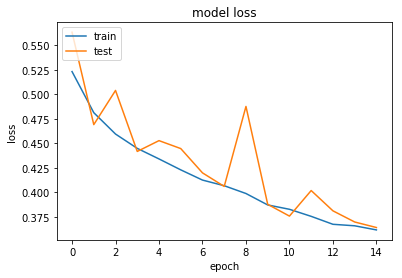

In [31]:
#Plot the losses
plt.plot(training.history['loss'])
plt.plot(training.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [32]:
model = load_model('best_model.h5')

y_pred_one_hot = model.predict(X_testRusReshaped)
y_pred_labels = np.argmax(y_pred_one_hot, axis = 1)

y_true_labels = np.argmax(Y_testRusHot,axis=1)

confusion_matrix = metrics.confusion_matrix(y_true=y_true_labels, y_pred=y_pred_labels)
print(confusion_matrix)

[[2533  624]
 [ 359 2798]]


### Evaluating performance

In [34]:
#Check Precision, Recall and F1-Score of both classes (0 and 1)
print(classification_report(y_true_labels, y_pred_labels))

              precision    recall  f1-score   support

           0       0.88      0.80      0.84      3157
           1       0.82      0.89      0.85      3157

   micro avg       0.84      0.84      0.84      6314
   macro avg       0.85      0.84      0.84      6314
weighted avg       0.85      0.84      0.84      6314



In [35]:
#Check the roc_auc_score
roc_auc_score(y_true_labels, y_pred_labels)

0.8443142223630028

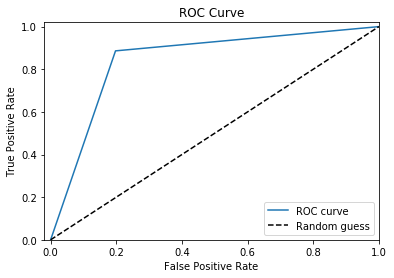

In [36]:
#ROC Curve
fpr, tpr, thresholds = roc_curve(y_true_labels, y_pred_labels)
#Create plot
plt.plot(fpr, tpr, label='ROC curve')
plt.plot([0, 1], [0, 1], 'k--', label='Random guess')
_ = plt.xlabel('False Positive Rate')
_ = plt.ylabel('True Positive Rate')
_ = plt.title('ROC Curve')
_ = plt.xlim([-0.02, 1])
_ = plt.ylim([0, 1.02])
_ = plt.legend(loc="lower right")

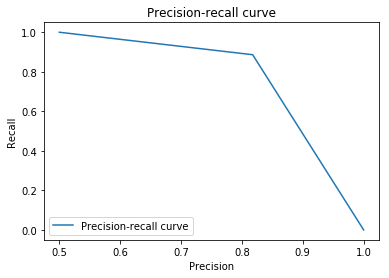

In [37]:
#Precision vs Recall Curve
precision, recall, thresholds = precision_recall_curve(y_true_labels, y_pred_labels)
#Create plot
plt.plot(precision, recall, label='Precision-recall curve')
_ = plt.xlabel('Precision')
_ = plt.ylabel('Recall')
_ = plt.title('Precision-recall curve')
_ = plt.legend(loc="lower left")

In [39]:
#Check accuracy score
accuracy_score(y_true_labels, y_pred_labels)

0.8443142223630028